<img src="https://miro.medium.com/max/647/1*ZOcUPrSXLYucFxppoI-dYg.png">

# Problem definition


For this project we are using a car dataset, where we want to predict the selling price of car based on its certain features.
Since we need to find the real value, with real calculation, therefore this problem is regression problem. 
We will be using linear regression to solve this problem.

General equation of Multiple Linear Regression:
$$y = \beta_0 + \beta_{1}x_1 + \beta_{2}x_2 + \beta_{3}x_3 + \beta_{4}x_4 + ... + \beta_{n}x_n$$

# Libraries

In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

from scipy.stats import skew

from sklearn.preprocessing import StandardScaler, PolynomialFeatures, OneHotEncoder,StandardScaler,PowerTransformer, MinMaxScaler, RobustScaler
from sklearn.model_selection import KFold, cross_val_predict, train_test_split,GridSearchCV,cross_val_score
from sklearn.linear_model import LinearRegression, Lasso, Ridge,ElasticNet
from sklearn.metrics import r2_score,mean_squared_error
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor, ExtraTreesRegressor
from sklearn.feature_selection import SelectKBest,SelectPercentile,f_classif,f_regression,mutual_info_regression
from xgboost import XGBRegressor
from xgboost import plot_importance


#importing plotly and cufflinks in offline mode
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

import warnings
warnings.filterwarnings('ignore')

plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

In [2]:
# !pip install xgboost

# Data Gathering

In [3]:
df0 = pd.read_csv("autoscoutpart_3_before_dummy(prev_owner).csv")

In [4]:
df = df0.copy()

# Data Preparation

In [5]:
df.head(5)

,make_model,body_type,price,vat,km,prev_owner,inspection_new,body_color,paint_type,nr._of_doors,nr._of_seats,gearing_type,cylinders,drive_chain,fuel,co2_emission,emission_class,comfort_convenience,entertainment_media,extras,safety_security,emission_label,gears,age,hp_kw,vehicle_condition,warranty_month,upholstery_type,upholstery_color,displacement_cc,weight_kg,cons_comb_l/100_km
0,Audi A1,Sedans,15770.0000000,YES deduction/negotiation,56013.0000000,2.0000000,Yes,Black,Metallic,5.0000000,5.0000000,Automatic,3.0000000,front,Diesel,99.0000000,Euro 6,"Air conditioning,Armrest,Automatic climate control,Cruise control,Electrical side mirrors,Hill Holder,Leather steering wheel,Light sensor,Multi-function steering wheel,Navigation system,Park Dista...","Bluetooth,Hands-free equipment,On-board computer,Radio","Alloy wheels,Catalytic Converter,Voice Control","ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Fog lights,Immobilizer,Isofix,Passenger-side airbag,Power steering,Side airbag,Tire pressure monitoring...",4.0000000,7.0000000,3.0000000,66.0000000,Used,no_warranty,Cloth,Black,1422.0000000,1220.0000000,3.8000000
1,Audi A1,Sedans,14500.0000000,YES deduction/negotiation,80000.0000000,1.0000000,No,Red,Metallic,3.0000000,4.0000000,Automatic,4.0000000,front,Benzin,129.0000000,Euro 6,"Air conditioning,Automatic climate control,Hill Holder,Leather steering wheel,Lumbar support,Parking assist system sensors rear,Power windows,Start-stop system,Tinted windows","Bluetooth,Hands-free equipment,On-board computer,Radio,Sound system","Alloy wheels,Sport seats,Sport suspension,Voice Control","ABS,Central door lock,Central door lock with remote control,Daytime running lights,Driver-side airbag,Electronic stability control,Head airbag,Immobilizer,Isofix,Passenger-side airbag,Power steeri...",4.0000000,7.0000000,2.0000000,141.0000000,Used,no_warranty,Cloth,Grey,1798.0000000,1255.0000000,5.6000000
2,Audi A1,Sedans,14640.0000000,YES deduction/negotiation,83450.0000000,1.0000000,Yes,Black,Metallic,4.0000000,4.0000000,Automatic,4.0000000,front,Diesel,99.0000000,Euro 6,"Air conditioning,Cruise control,Electrical side mirrors,Hill Holder,Leather steering wheel,Multi-function steering wheel,Navigation system,Park Distance Control,Parking assist system sensors front...","MP3,On-board computer","Alloy wheels,Voice Control","ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Immobilizer,Isofix,Passenger-side airbag,Power steering,Side airbag,Tire pressure monitoring system,Tra...",4.0000000,7.0000000,3.0000000,85.0000000,Used,no_warranty,Cloth,Black,1598.0000000,1275.0000000,3.8000000
3,Audi A1,Sedans,14500.0000000,NO deduction/negotiation,73000.0000000,1.0000000,Yes,Brown,Metallic,3.0000000,4.0000000,Automatic,3.0000000,front,Diesel,99.0000000,Euro 6,"Air suspension,Armrest,Auxiliary heating,Electrical side mirrors,Heads-up display,Hill Holder,Leather steering wheel,Light sensor,Lumbar support,Multi-function steering wheel,Navigation system,Pow...","Bluetooth,CD player,Hands-free equipment,MP3,On-board computer,Radio,Sound system,USB","Alloy wheels,Sport seats,Voice Control","ABS,Alarm system,Central door lock with remote control,Driver drowsiness detection,Driver-side airbag,Electronic stability control,Emergency system,Head airbag,Immobilizer,Isofix,Passenger-side ai...",4.0000000,6.0000000,3.0000000,66.0000000,Used,no_warranty,Other,Other,1422.0000000,1195.0000000,3.8000000
4,Audi A1,Sedans,16790.0000000,NO deduction/negotiation,16200.0000000,1.0000000,Yes,Black,Metallic,5.0000000,5.0000000,Automatic,3.0000000,front,Diesel,109.0000000,Euro 6,"Air conditioning,Armrest,Automatic climate control,Electrical side mirrors,Hill Holder,Leather steering wheel,Light sensor,Multi-function steering wheel,Park Distance Control,Parking assist system...","Bluetooth,CD player,Hands-free equipment,MP3,On-board computer,Radio,USB","Alloy wheels,Sport package,Sport suspension,Voice Control

In [6]:
df.columns

Index(['make_model', 'body_type', 'price', 'vat', 'km', 'prev_owner',
       'inspection_new', 'body_color', 'paint_type', 'nr._of_doors',
       'nr._of_seats', 'gearing_type', 'cylinders', 'drive_chain', 'fuel',
       'co2_emission', 'emission_class', 'comfort_convenience',
       'entertainment_media', 'extras', 'safety_security', 'emission_label',
       'gears', 'age', 'hp_kw', 'vehicle_condition', 'warranty_month',
       'upholstery_type', 'upholstery_color', 'displacement_cc', 'weight_kg',
       'cons_comb_l/100_km'],
      dtype='object')

In [7]:
df.shape

(15919, 32)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15919 entries, 0 to 15918
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   make_model           15919 non-null  object 
 1   body_type            15919 non-null  object 
 2   price                15919 non-null  float64
 3   vat                  15919 non-null  object 
 4   km                   15919 non-null  float64
 5   prev_owner           15919 non-null  float64
 6   inspection_new       15919 non-null  object 
 7   body_color           15919 non-null  object 
 8   paint_type           15919 non-null  object 
 9   nr._of_doors         15919 non-null  float64
 10  nr._of_seats         15919 non-null  float64
 11  gearing_type         15919 non-null  object 
 12  cylinders            15919 non-null  float64
 13  drive_chain          15919 non-null  object 
 14  fuel                 15919 non-null  object 
 15  co2_emission         15919 non-null 

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
price,15919.0000000,18022.6225265,7381.7978245,4950.0000000,12850.0000000,16900.0000000,21900.0000000,74600.0000000
km,15919.0000000,32082.6320965,36975.5023755,0.0000000,1906.5000000,20407.0000000,46898.5000000,317000.0000000
prev_owner,15919.0000000,1.0491237,0.3290578,0.0000000,1.0000000,1.0000000,1.0000000,4.0000000
nr._of_doors,15919.0000000,4.6599033,0.6419946,2.0000000,4.0000000,5.0000000,5.0000000,5.0000000
nr._of_seats,15919.0000000,4.9471072,0.4857218,2.0000000,5.0000000,5.0000000,5.0000000,7.0000000
cylinders,15919.0000000,3.7857906,0.4136405,3.0000000,4.0000000,4.0000000,4.0000000,5.0000000
co2_emission,15919.0000000,118.0817262,16.9516409,91.0000000,105.0000000,117.0000000,128.0000000,189.0000000
emission_label,15919.0000000,3.9284503,0.4595393,1.0000000,4.0000000,4.0000000,4.0000000,5.0000000
gears,15919.0000000,5.9479867,0.7306981,5.0000000,5.0000000,6.0000000,6.0000000,9.0000000
age,15919.0000000,1.3894089,1.1213318,0.0000000,0.0000000,1.0000000,2.0000000,3.0000000


In [43]:
df.select_dtypes(include ="object").head(3).T
# inClass

,0,1,2
make_model,Audi A1,Audi A1,Audi A1
body_type,Sedans,Sedans,Sedans
vat,YES deduction/negotiation,YES deduction/negotiation,YES deduction/negotiation
inspection_new,Yes,No,Yes
body_color,Black,Red,Black
paint_type,Metallic,Metallic,Metallic
gearing_type,Automatic,Automatic,Automatic
drive_chain,front,front,front
fuel,Diesel,Benzin,Diesel
emission_class,Euro 6,Euro 6,Euro 6


In [44]:
for col in df.select_dtypes('object').columns:
    print(f"{col:<20}:", df[col].nunique())
# inClass

make_model          : 9
body_type           : 9
vat                 : 2
inspection_new      : 2
body_color          : 15
paint_type          : 3
gearing_type        : 3
drive_chain         : 2
fuel                : 5
emission_class      : 3
comfort_convenience : 6198
entertainment_media : 346
extras              : 659
safety_security     : 4443
vehicle_condition   : 2
warranty_month      : 2
upholstery_type     : 6
upholstery_color    : 10


In [10]:
df.describe(include=object).T

,count,unique,top,freq
make_model,15919,9,Audi A3,3097
body_type,15919,9,Sedans,7923
vat,15919,2,YES deduction/negotiation,11406
inspection_new,15919,2,Yes,12818
body_color,15919,15,Black,3899
paint_type,15919,3,Metallic,15504
gearing_type,15919,3,Manual,8153
drive_chain,15919,2,front,15675
fuel,15919,5,Benzin,8545
emission_class,15919,3,Euro 6,15799


In [40]:
# Numeric ve Categoric sütunların tespiti kapsamında kullanılacak.

numerical= df.drop(['price'], axis=1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print(f'Numerical Columns:  {df[numerical].columns}')
print('\n')
print(f'Categorical Columns: {df[categorical].columns}')

Numerical Columns:  Index(['km', 'prev_owner', 'nr._of_doors', 'nr._of_seats', 'cylinders',
       'co2_emission', 'emission_label', 'gears', 'age', 'hp_kw',
       'displacement_cc', 'weight_kg', 'cons_comb_l/100_km'],
      dtype='object')


Categorical Columns: Index(['make_model', 'body_type', 'vat', 'inspection_new', 'body_color',
       'paint_type', 'gearing_type', 'drive_chain', 'fuel', 'emission_class',
       'comfort_convenience', 'entertainment_media', 'extras',
       'safety_security', 'vehicle_condition', 'warranty_month',
       'upholstery_type', 'upholstery_color'],
      dtype='object')


Tekrar eden row olup olmadığını kontrol ediyoruz. Tekrar eden row var ise bunları DROP etmek uygun olur.

In [11]:
df.duplicated().sum()

1510

In [18]:
df.duplicated().value_counts()

False    14409
True      1510
dtype: int64

In [19]:
df[df.duplicated() == True]

,make_model,body_type,price,vat,km,prev_owner,inspection_new,body_color,paint_type,nr._of_doors,nr._of_seats,gearing_type,cylinders,drive_chain,fuel,co2_emission,emission_class,comfort_convenience,entertainment_media,extras,safety_security,emission_label,gears,age,hp_kw,vehicle_condition,warranty_month,upholstery_type,upholstery_color,displacement_cc,weight_kg,cons_comb_l/100_km
81,Audi A1,Sedans,18500.0000000,YES deduction/negotiation,13406.0000000,1.0000000,Yes,Black,Metallic,5.0000000,5.0000000,Automatic,4.0000000,front,Diesel,99.0000000,Euro 6,"Air conditioning,Armrest,Auxiliary heating,Electrically heated windshield,Electrical side mirrors,Hill Holder,Leather steering wheel,Multi-function steering wheel,Navigation system,Power windows,S...","Bluetooth,CD player,Hands-free equipment,MP3,On-board computer,Radio","Alloy wheels,Catalytic Converter,Shift paddles,Voice Control","Alarm system,Central door lock,Daytime running lights,Driver-side airbag,Isofix,LED Daytime Running Lights,Passenger-side airbag,Power steering,Side airbag,Tire pressure monitoring system,Traction...",1.0000000,7.0000000,1.0000000,85.0000000,Used,no_warranty,Cloth,Other,1598.0000000,1275.0000000,3.8000000
123,Audi A1,Sedans,18700.0000000,YES deduction/negotiation,27000.0000000,1.0000000,No,Grey,Metallic,5.0000000,4.0000000,Automatic,4.0000000,front,Diesel,97.0000000,Euro 6,"Air conditioning,Armrest,Cruise control,Electrical side mirrors,Leather steering wheel,Multi-function steering wheel,Navigation system,Park Distance Control,Parking assist system sensors rear,Powe...","Bluetooth,CD player,Hands-free equipment,MP3,On-board computer,Radio,USB",Alloy wheels,"ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Fog lights,Immobilizer,Isofix,Passenger-side airbag,Power steering,Side airbag,Traction control",4.0000000,7.0000000,3.0000000,85.0000000,Used,yes_warranty,Cloth,Grey,1598.0000000,1275.0000000,3.7000000
136,Audi A1,Compact,18333.0000000,YES deduction/negotiation,4800.0000000,1.0000000,Yes,Black,Metallic,4.0000000,4.0000000,Automatic,3.0000000,front,Benzin,97.0000000,Euro 6,"Air conditioning,Electrical side mirrors,Hill Holder,Leather steering wheel,Lumbar support,Multi-function steering wheel,Park Distance Control,Parking assist system sensors rear,Power windows,Seat...","Bluetooth,CD player,Hands-free equipment,MP3,On-board computer,Radio,USB","Alloy wheels,Sport seats,Voice Control","ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Fog lights,Immobilizer,Isofix,Passenger-side airbag,Power steering,Side airbag,Tire pressure monitoring...",4.0000000,7.0000000,1.0000000,70.0000000,Used,no_warranty,Cloth,Grey,999.0000000,1165.0000000,4.4000000
231,Audi A1,Sedans,16500.0000000,NO deduction/negotiation,25000.0000000,1.0000000,Yes,Brown,Metallic,5.0000000,5.0000000,Automatic,4.0000000,front,Benzin,120.0000000,Euro 6,"Air conditioning,Automatic climate control,Navigation system,Park Distance Control,Power windows,Seat heating,Start-stop system",Radio,"Alloy wheels,Sport seats,Voice Control","ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Immobilizer,Passenger-side airbag,Power steering,Side airbag,Traction control",4.0000000,7.0000000,3.0000000,92.0000000,Used,yes_warranty,Other,Other,1395.0000000,1660.0000000,4.9000000
287,Audi A1,Sedans,15090.0000000,NO deduction/negotiation,63668.0000000,1.0000000,Yes,White,Metallic,4.0000000,5.0000000,Automatic,4.0000000,front,Diesel,97.0000000,Euro 6,"Air conditioning,Armrest,Automatic climate control,Electrical side mirrors,Hill Holder,Keyless central door lock,Leather steering wheel,Light sensor,Lumbar support,Multi-function steering wheel,Na...","Bluetooth,Hands-free equipment,On-board computer,Radio,Sound system,USB","Alloy wheels,Sport package,Sport seats,Sport suspension","ABS,Central door lock,Daytime running lights,Driver-side airbag,Electronic stability control,Fog lights,Immobi

In [22]:
df = df.drop_duplicates()

In [23]:
df.shape

(14409, 32)

**Missing Value Sayıları ve Oranlarının Kontrolü**

In [24]:
# Column lara göre column ların içerdiği missing value oranını görüntülemek için kullanılabilir.

df.isnull().sum()/df.shape[0]*100

make_model            0.0000000
body_type             0.0000000
price                 0.0000000
vat                   0.0000000
km                    0.0000000
prev_owner            0.0000000
inspection_new        0.0000000
body_color            0.0000000
paint_type            0.0000000
nr._of_doors          0.0000000
nr._of_seats          0.0000000
gearing_type          0.0000000
cylinders             0.0000000
drive_chain           0.0000000
fuel                  0.0000000
co2_emission          0.0000000
emission_class        0.0000000
comfort_convenience   0.0000000
entertainment_media   0.0000000
extras                0.0000000
safety_security       0.0000000
emission_label        0.0000000
gears                 0.0000000
age                   0.0000000
hp_kw                 0.0000000
vehicle_condition     0.0000000
warranty_month        0.0000000
upholstery_type       0.0000000
upholstery_color      0.0000000
displacement_cc       0.0000000
weight_kg             0.0000000
cons_com

In [25]:
# Missing value içeren satırları görüntülemek için kullanılabilir.

miss_val = []
[miss_val.append(i) for i in df.columns if any(df[i].isnull())]
miss_val

[]

In [26]:
# Kaan Hoca dan alınan 

def missing (df):
    missing_number = df.isnull().sum().sort_values(ascending=False)
    missing_percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(df)

,Missing_Number,Missing_Percent
make_model,0,0.0000000
body_type,0,0.0000000
weight_kg,0,0.0000000
displacement_cc,0,0.0000000
upholstery_color,0,0.0000000
upholstery_type,0,0.0000000
warranty_month,0,0.0000000
vehicle_condition,0,0.0000000
hp_kw,0,0.0000000
age,0,0.0000000


**Veri setimizdeki sütunların içerikleri kapsamında incelememiz ve veri setini tanımamız gerekli. Bu nedenle tek tek sütunları inceleyeceğiz.**

In [27]:
# Birer birer column incelemesi yapıldığında, her column özelinde, ilgili column ile ilgili bilgileri almak için kullanılacak kod.

def first_looking(col):
    print("column name    : ", col)
    print("--------------------------------")
    print("per_of_nulls   : ", "%", round(df[col].isnull().sum()/df.shape[0]*100, 2))
    print("num_of_nulls   : ", df[col].isnull().sum())
    print("num_of_uniques : ", df[col].nunique())
    print(df[col].value_counts(dropna = False))

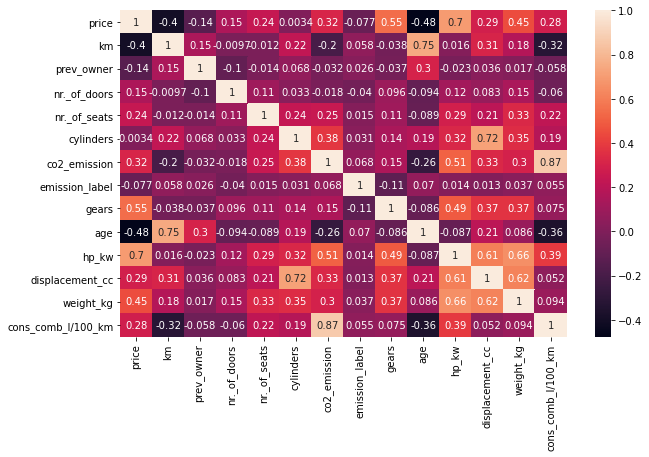

In [28]:
sns.heatmap(df.corr(), annot=True);

In [66]:
df_numeric.corr()[abs((df_numeric.corr()>= 0.9)) & abs((df_numeric.corr() < 1))].any().any()
# inClass

False

In [29]:
df.nunique()

make_model                9
body_type                 9
price                  2952
vat                       2
km                     6692
prev_owner                5
inspection_new            2
body_color               15
paint_type                3
nr._of_doors              4
nr._of_seats              4
gearing_type              3
cylinders                 3
drive_chain               2
fuel                      5
co2_emission             83
emission_class            3
comfort_convenience    6198
entertainment_media     346
extras                  659
safety_security        4443
emission_label            5
gears                     5
age                       4
hp_kw                    77
vehicle_condition         2
warranty_month            2
upholstery_type           6
upholstery_color         10
displacement_cc          68
weight_kg               432
cons_comb_l/100_km       58
dtype: int64

There is no zero variance variable.
Car ID column is repetition of the index. So I'll drop it.
Carname has 147 different entity. I'll check it. And try to find a way to reduce the variance.
Other than that there is no problem.


# The Examination of Target Variable

In [34]:
df['price'].describe()

count   14409.0000000
mean    18127.9841072
std      7421.6342255
min      4950.0000000
25%     12950.0000000
50%     16970.0000000
75%     21900.0000000
max     74600.0000000
Name: price, dtype: float64

In [35]:
print( f"Skewness: {df['price'].skew()}")

Skewness: 1.2588533311224817


In [33]:
df['price'].iplot(kind='hist')

- Even though target variable has right skewness, I will not make any transformation on it.

## Numerical Features

- Let's see the numerical features

In [65]:
df_numeric = df.select_dtypes(include ="number")
df_numeric
# inClass

,price,km,prev_owner,nr._of_doors,nr._of_seats,cylinders,co2_emission,emission_label,gears,age,hp_kw,displacement_cc,weight_kg,cons_comb_l/100_km
0,15770.000,56013.000,2.000,5.000,5.000,3.000,99.000,4.000,7.000,3.000,66.000,1422.000,1220.000,3.800
1,14500.000,80000.000,1.000,3.000,4.000,4.000,129.000,4.000,7.000,2.000,141.000,1798.000,1255.000,5.600
2,14640.000,83450.000,1.000,4.000,4.000,4.000,99.000,4.000,7.000,3.000,85.000,1598.000,1275.000,3.800
3,14500.000,73000.000,1.000,3.000,4.000,3.000,99.000,4.000,6.000,3.000,66.000,1422.000,1195.000,3.800
4,16790.000,16200.000,1.000,5.000,5.000,3.000,109.000,4.000,7.000,3.000,66.000,1422.000,1195.000,4.100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15913,39950.000,1000.000,1.000,5.000,7.000,4.000,153.000,4.000,7.000,0.000,165.000,1798.000,1685.000,6.800
15914,39950.000,1652.839,1.000,5.000,5.000,4.000,139.000,4.000,6.000,0.000,147.000,1997.000,1758.000,5.300
15915,39885.000,9900.000,1.000,5.000,5.000,4.000,168.000,4.000,7.000,0.000,165.000,1798.000,1708.000,7.400
15916,39875.000,15.000,1.000,5.000,7.000,4.000,139.000,4.000,6.000,0.000,146.000,1997.000,1840.000,5.300


In [29]:
df[numerical].describe()

,km,prev_owner,nr._of_doors,nr._of_seats,cylinders,co2_emission,emission_label,gears,age,hp_kw,displacement_cc,weight_kg,cons_comb_l/100_km
count,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000,15919.0000000
mean,32082.6320965,1.0491237,4.6599033,4.9471072,3.7857906,118.0817262,3.9284503,5.9479867,1.3894089,88.5119668,1427.0868145,1343.3019034,4.8259124
std,36975.5023755,0.3290578,0.6419946,0.4857218,0.4136405,16.9516409,0.4595393,0.7306981,1.1213318,26.7127995,276.8746597,207.6420712,0.9272399
min,0.0000000,0.0000000,2.0000000,2.0000000,3.0000000,91.0000000,1.0000000,5.0000000,0.0000000,40.0000000,890.0000000,840.0000000,3.0000000
25%,1906.5000000,1.0000000,4.0000000,5.0000000,4.0000000,105.0000000,4.0000000,5.0000000,0.0000000,66.0000000,1229.0000000,1165.0000000,4.0000000
50%,20407.0000000,1.0000000,5.0000000,5.0000000,4.0000000,117.0000000,4.0000000,6.0000000,1.0000000,85.0000000,1461.0000000,1285.0000000,4.8000000
75%,46898.5000000,1.0000000,5.0000000,5.0000000,4.0000000,128.0000000,4.0000000,6.0000000,2.0000000,103.0000000,1598.0000000,1472.0000000,5.4000000
max,317000.0000000,4.0000000,5.0000000,7.0000000,5.0000000,189.0000000,5.0000000,9.0000000,3.0000000,294.0000000,2967.0000000,2471.0000000,13.8000000


In [41]:
df[numerical].iplot(kind='hist');

In [67]:
df[numerical].iplot(kind='histogram',subplots=True,bins=50)

Several features have gaussian-normal like ditsribution.
I have also observed skewness.
I'll look those in details.

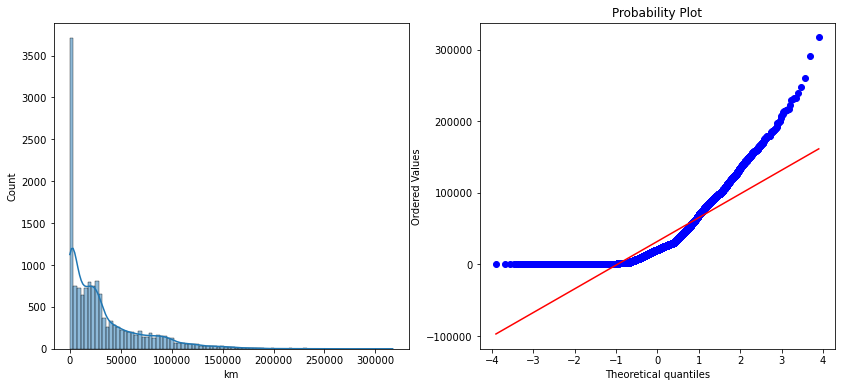

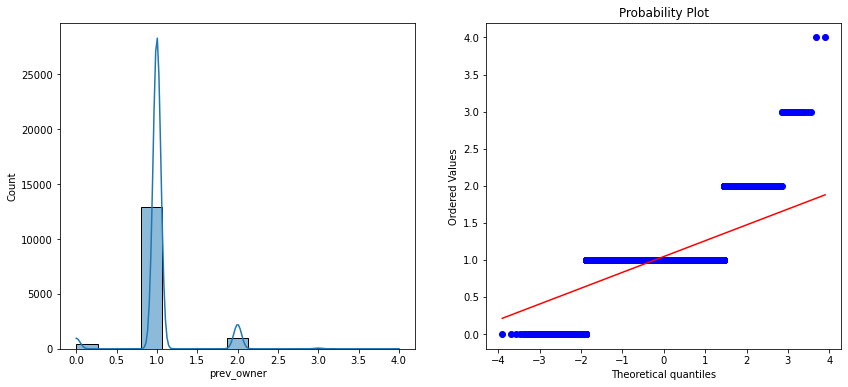

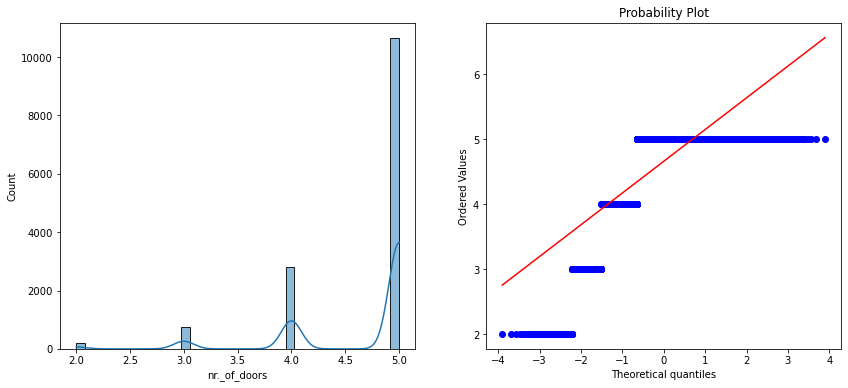

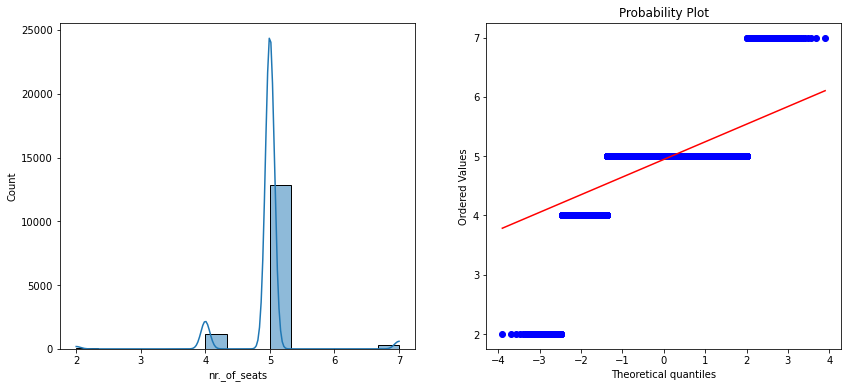

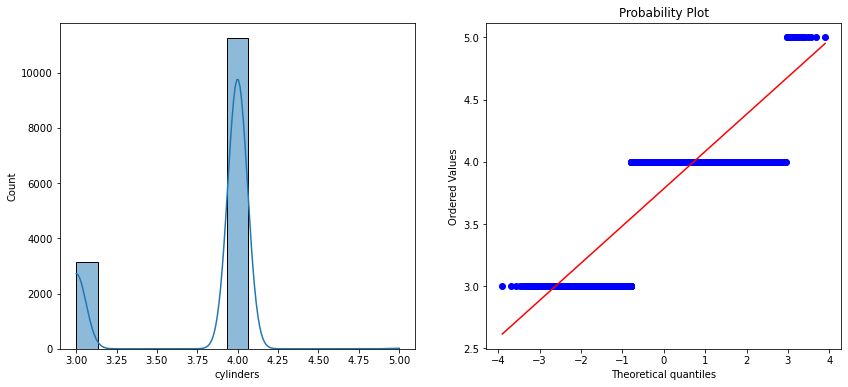

...

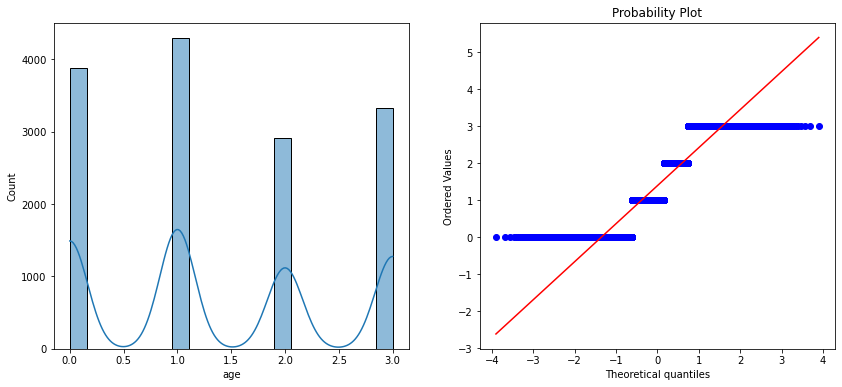

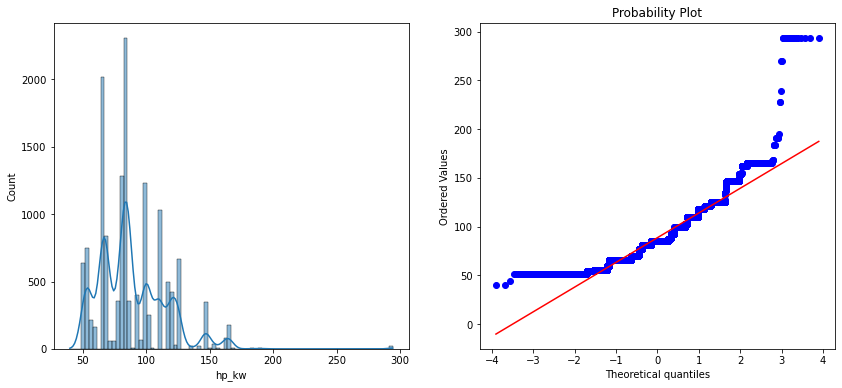

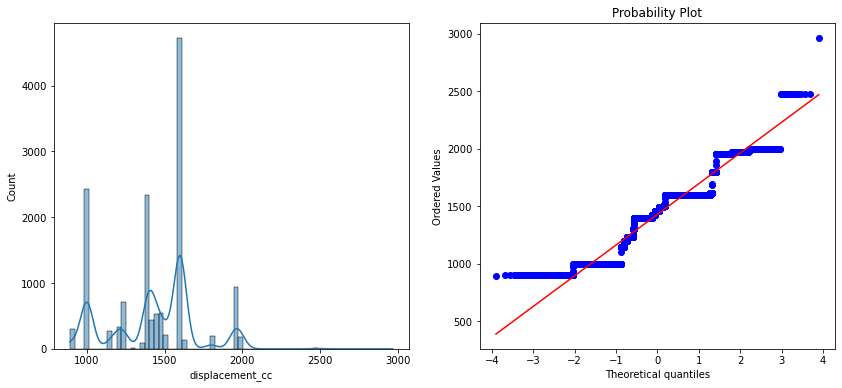

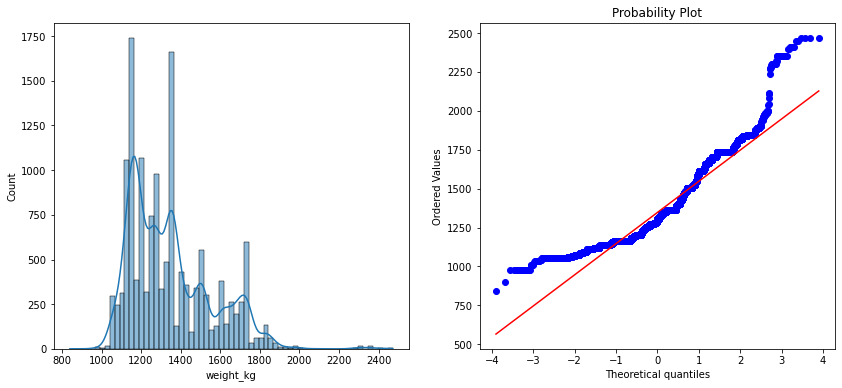

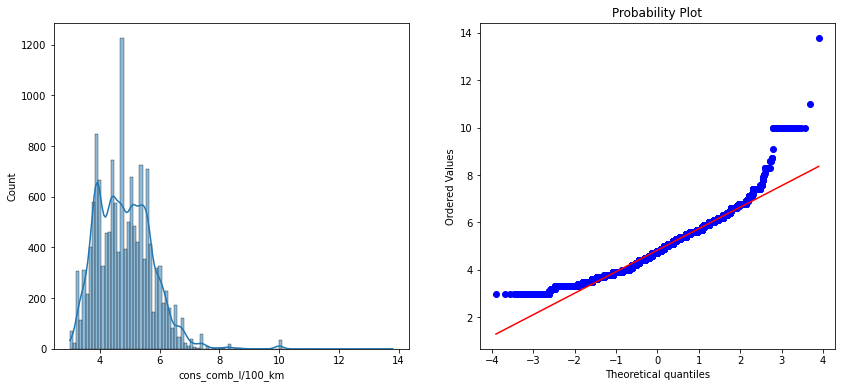

In [68]:
for col in df_numeric.iloc[:,1:]:
    check_dist(df_numeric, col)
# inClass

In [69]:
for i in df_numeric:
    print(f"{i:<16}:  {skew(df[i]):.3f}")

# inClass

price           :  1.259
km              :  1.670
prev_owner      :  1.279
nr._of_doors    :  -1.976
nr._of_seats    :  -0.475
cylinders       :  -1.314
co2_emission    :  0.882
emission_label  :  -6.292
gears           :  0.413
age             :  0.183
hp_kw           :  1.335
displacement_cc :  -0.064
weight_kg       :  1.039
cons_comb_l/100_km:  0.871


In [47]:
skew_limit = 0.75 # This is our threshold-limit to evaluate skewness. Overall below abs(1) seems acceptable for the linear models. 
skew_vals = df[numerical].skew()
skew_cols= skew_vals[abs(skew_vals)> skew_limit].sort_values(ascending=False)
skew_cols

km                    1.6698595
hp_kw                 1.3354550
prev_owner            1.2787711
weight_kg             1.0388329
co2_emission          0.8818268
cons_comb_l/100_km    0.8706586
cylinders            -1.3145127
nr._of_doors         -1.9762813
emission_label       -6.2924732
dtype: float64

In [48]:
df[skew_cols.index].iplot(kind='hist');

In [49]:
df[skew_cols.index].iplot(kind='histogram',subplots=True,bins=50)

- Since this is a beginner friendly notebook, let's see several options in the practice without touching our main dataset.
- First I'll show np.log method.
- Then I'll use transformation methods.

### With np.log

In [50]:
df_try = df.copy()

for col in skew_cols.index.values:
    df_try[col] = df_try[col].apply(np.log1p)

print(df_try[skew_cols.index].skew())
print()

df_try[skew_cols.index].iplot(kind='histogram',subplots=True,bins=50);

km                   -1.4450981
hp_kw                 0.2568009
prev_owner           -1.2053619
weight_kg             0.6772417
co2_emission          0.5056511
cons_comb_l/100_km    0.2544142
cylinders            -1.3346129
nr._of_doors         -2.4164181
emission_label       -6.3182965
dtype: float64



### With Power Transformer

In [51]:
df_trans = df[skew_cols.index].copy()
pt = PowerTransformer(method='yeo-johnson')
trans= pt.fit_transform(df_trans)
df_trans = pd.DataFrame(trans, columns =skew_cols.index )
print(df_trans.skew())
print()
df_trans.iplot(kind='histogram',subplots=True,bins=50);

km                   -0.3401570
hp_kw                 0.0111975
prev_owner            0.2525057
weight_kg             0.0906434
co2_emission          0.0519231
cons_comb_l/100_km    0.0056355
cylinders             0.5791738
nr._of_doors         -1.0989100
emission_label        6.4548350
dtype: float64



- During the modelling process, we can use power transformer.

- Let's observe the correlation among the numerical features
- And also observe the correlation with the target variable

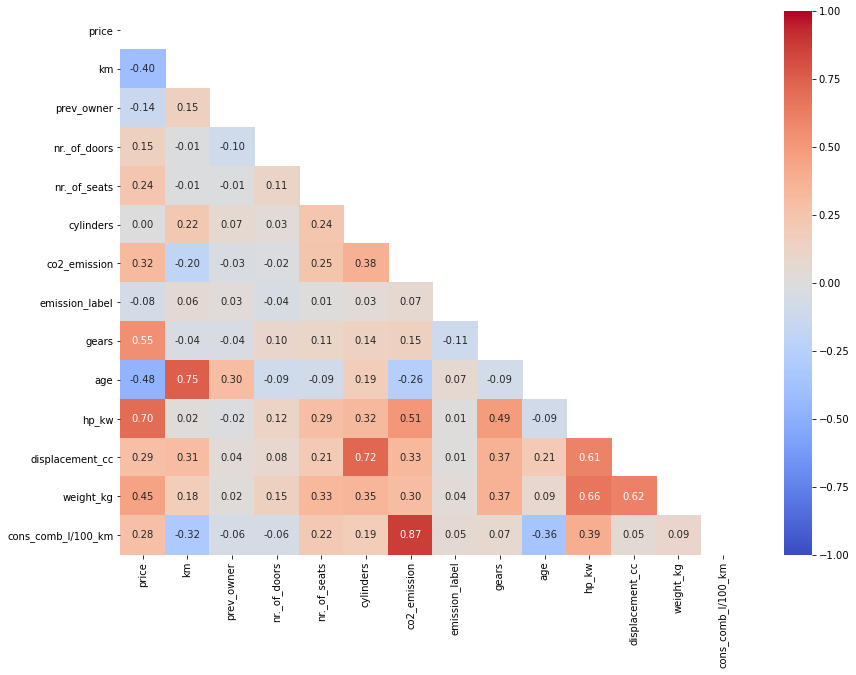

In [70]:
numerical1= df.select_dtypes('number').columns

matrix = np.triu(df[numerical1].corr())
fig, ax = plt.subplots(figsize=(14,10)) 
sns.heatmap (df[numerical1].corr(), annot=True, fmt= '.2f', vmin=-1, vmax=1, center=0, cmap='coolwarm',mask=matrix, ax=ax);

- We have 9 numerical features which have more than .5 correlation with the price variable.
- Which is a good sign for the prediction capability of the model, but still we need to see in the practice.
- From the threshold .9 perspective: Highwaympg and citympg has .97 correlation. We can drop one of them to avoid multicollinearity problems for the linear models.
- I have observed several highly correlated features below the .9 level.

## Categorical Features

In [71]:
df[categorical].head().T

,0,1,2,3,4
make_model,Audi A1,Audi A1,Audi A1,Audi A1,Audi A1
body_type,Sedans,Sedans,Sedans,Sedans,Sedans
vat,YES deduction/negotiation,YES deduction/negotiation,YES deduction/negotiation,NO deduction/negotiation,NO deduction/negotiation
inspection_new,Yes,No,Yes,Yes,Yes
body_color,Black,Red,Black,Brown,Black
paint_type,Metallic,Metallic,Metallic,Metallic,Metallic
gearing_type,Automatic,Automatic,Automatic,Automatic,Automatic
drive_chain,front,front,front,front,front
fuel,Diesel,Benzin,Diesel,Diesel,Diesel
emission_class,Euro 6,Euro 6,Euro 6,Euro 6,Euro 6


In [56]:
def check_dist(df, var):
    plt.figure(figsize=(14, 6))
    plt.subplot(1, 2, 1)
    sns.histplot(x=df[var], kde=True)
    plt.subplot(1, 2, 2)
    stats.probplot(df[var], dist='norm', plot=plt)
    plt.show()
# inClass

### make_model & price

<AxesSubplot:xlabel='price'>

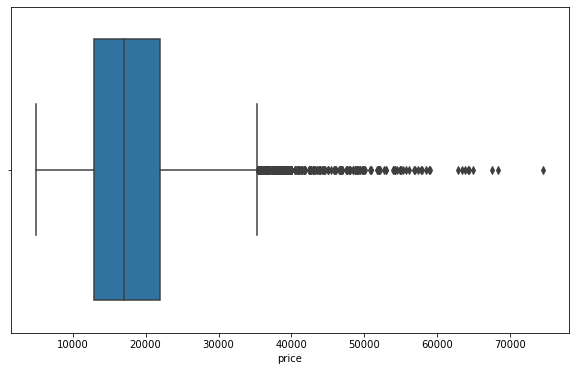

In [72]:
sns.boxplot(df.price)

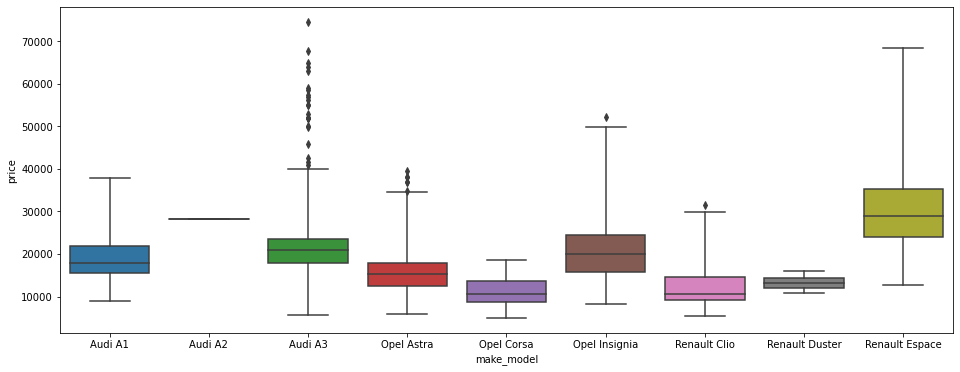

In [73]:
plt.figure(figsize=(16,6))
sns.boxplot(x="make_model", y="price", data=df, whis=3)
plt.show()

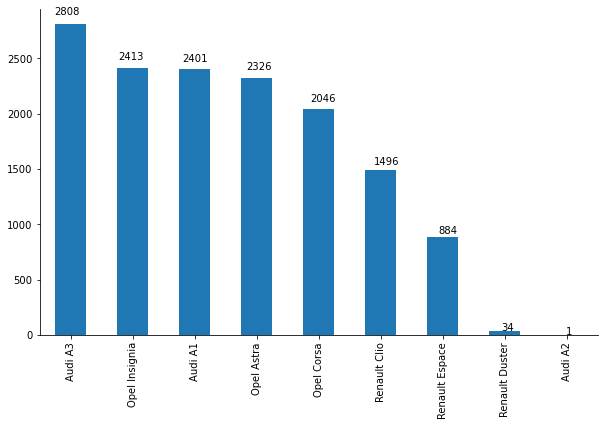

In [57]:
ax = df.make_model.value_counts().plot(kind ="bar")
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
#ax.axis("off")
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.03, p.get_height() * 1.03))
# inClass

Audi A1


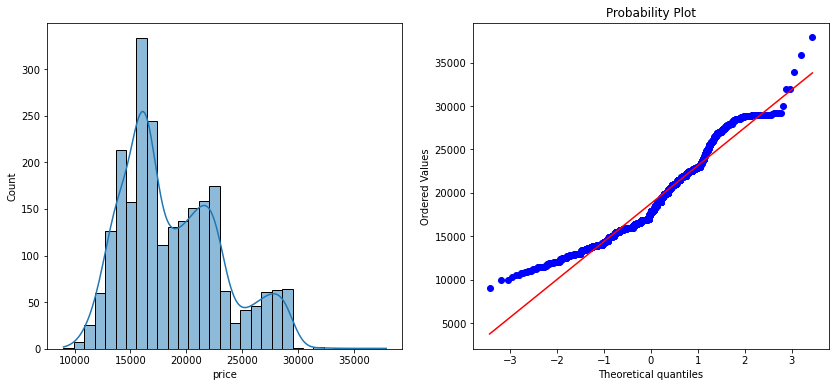

Audi A2


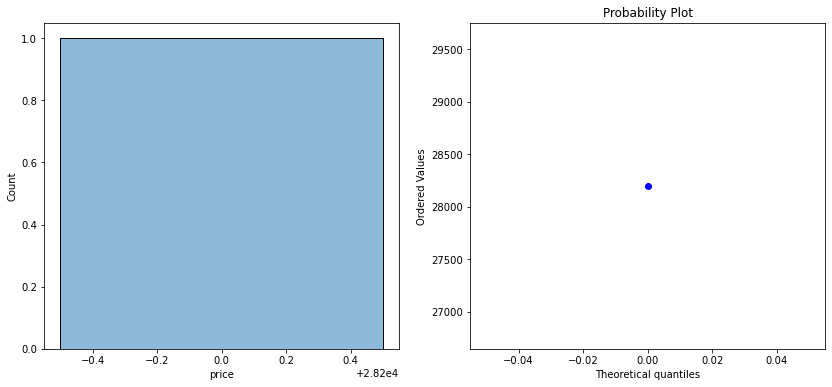

Audi A3


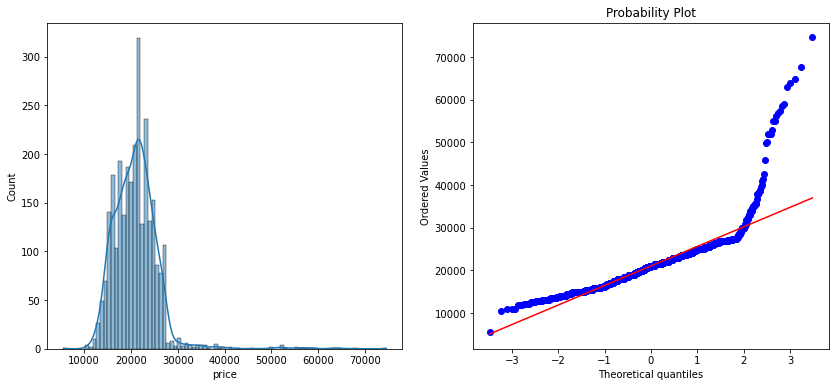

Opel Astra


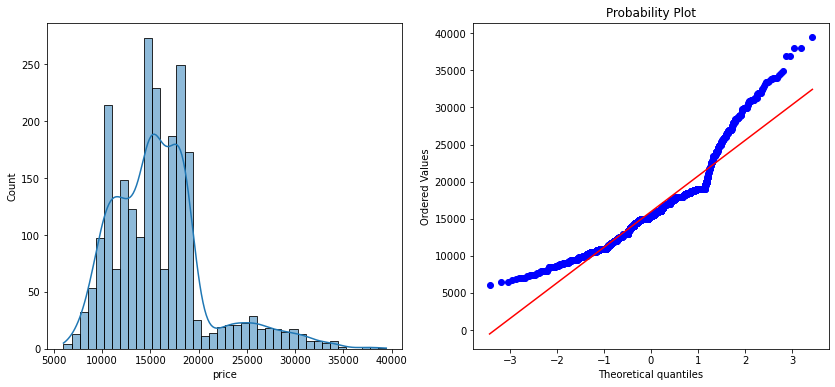

Opel Corsa


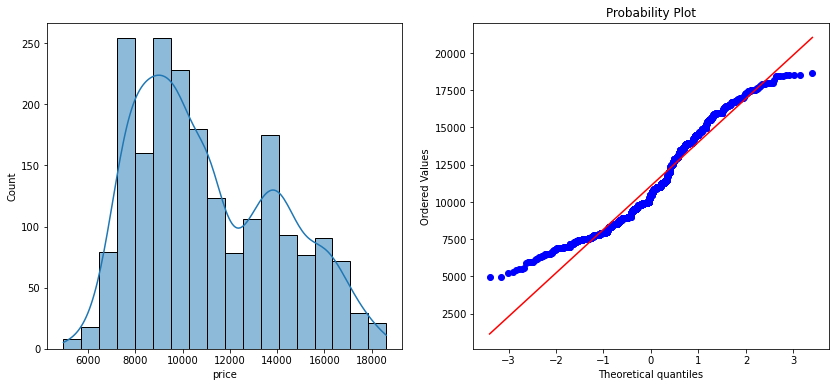

Opel Insignia


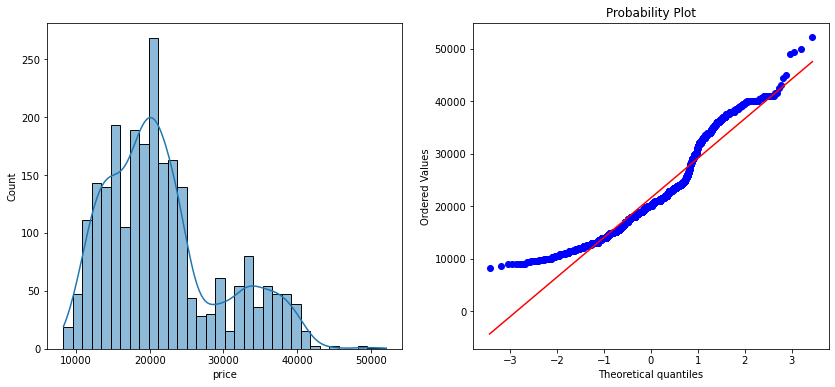

Renault Clio


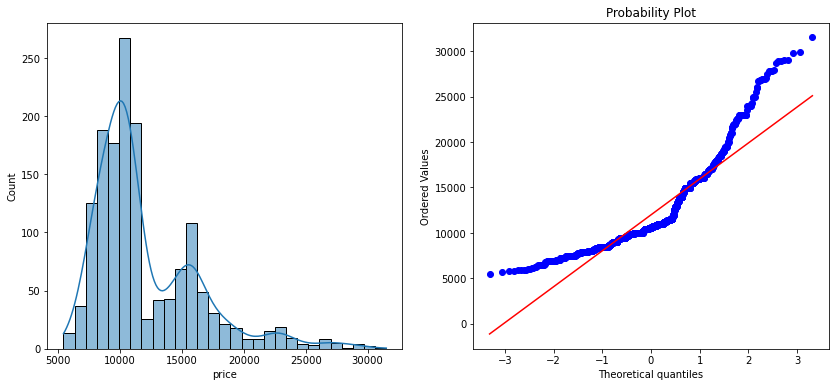

Renault Duster


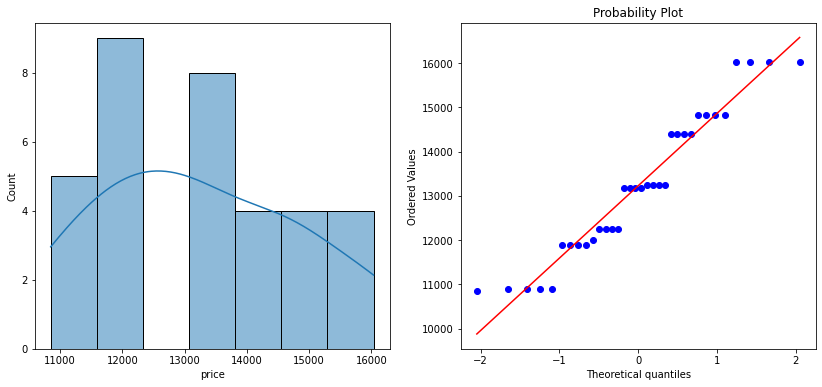

Renault Espace


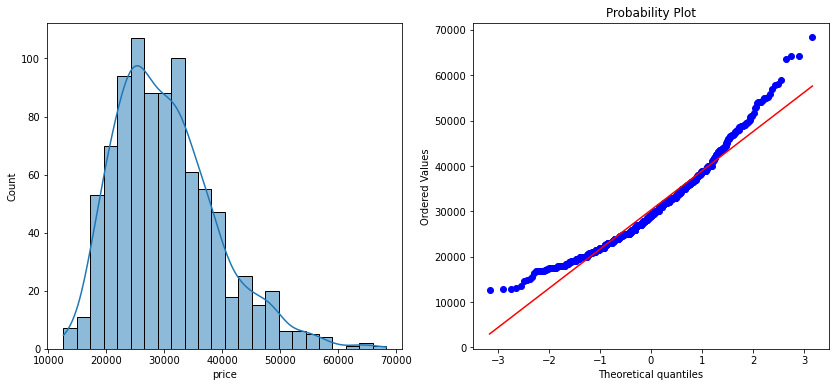

In [58]:
for col in df.make_model.unique():
    print(col)
    check_dist(df[df["make_model"] ==col], "price")
# inClass

In [63]:
for i in df.make_model.unique():
    print(i, "\t:", skew(df[df["make_model"] ==i]["price"]))
# inClass

Audi A1 	: 0.6395369178344323
Audi A2 	: 0.0
Audi A3 	: 2.9686091412988005
Opel Astra 	: 1.1901279449945044
Opel Corsa 	: 0.47654980053118196
Opel Insignia 	: 0.832257419514376
Renault Clio 	: 1.5143073768006075
Renault Duster 	: 0.2268067802692965
Renault Espace 	: 0.8690063764748583


In [39]:
print(df.groupby('make_model')['price'].mean().sort_values())
print()
df.groupby('make_model')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

make_model
Opel Corsa       11060.0504732
Renault Clio     11940.3208265
Renault Duster   13230.1764706
Opel Astra       15840.4615994
Audi A1          18864.6889824
Audi A3          20996.6932515
Opel Insignia    21463.4518861
Audi A2          28200.0000000
Renault Espace   30080.2119072
Name: price, dtype: float64



### body_type & price

In [74]:
print(df.groupby('body_type')['price'].mean().sort_values())
print()
df.groupby('body_type')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

body_type
Coupe           14222.720
Other           14268.854
Compact         15351.977
Transporter     16278.913
Off-Road        17126.161
Sedans          17749.416
Station wagon   18818.508
Convertible     27905.375
Van             30837.041
Name: price, dtype: float64



- Based on the price, there are differences among the carbody.
- While Wagon cars the leats expensive ones, hardtop and the convertibles are the most expensive ones.

### vat & price

In [41]:
print(df.groupby('vat')['price'].mean().sort_values())
print()
df.groupby('vat')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

vat
NO deduction/negotiation    16535.6060270
YES deduction/negotiation   18610.9887778
Name: price, dtype: float64



### inspection_new & price

In [42]:
print(df.groupby('inspection_new')['price'].mean().sort_values())
print()
df.groupby('inspection_new')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

inspection_new
No    15584.2663657
Yes   18612.5228585
Name: price, dtype: float64



### body_color & price

In [43]:
print(df.groupby('body_color')['price'].mean().sort_values())
print()
df.groupby('body_color')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

body_color
Gold     14556.5000000
Red      15692.6887967
Silver   16531.5951103
Beige    16785.4907407
Blue     17184.1330117
White    17340.5734423
Bronze   17458.1666667
Green    17820.6948052
Orange   18166.6666667
Brown    18663.2975779
Black    19050.7448064
Grey     19073.2592790
Violet   23005.3888889
Yellow   23971.1372549
Gray     25118.0000000
Name: price, dtype: float64



### paint_type & price

In [44]:
print(df.groupby('paint_type')['price'].mean().sort_values())
print()
df.groupby('paint_type')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

paint_type
Uni/basic     17646.0388601
Metallic      18030.7566434
Perl effect   18686.4137931
Name: price, dtype: float64



### gearing_type & price

In [45]:
print(df.groupby('gearing_type')['price'].mean().sort_values())
print()
df.groupby('gearing_type')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

gearing_type
Manual           14911.8708451
Automatic        21163.1762368
Semi-automatic   23236.5628998
Name: price, dtype: float64



### drive_chain & price

In [46]:
print(df.groupby('drive_chain')['price'].mean().sort_values())
print()
df.groupby('drive_chain')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

drive_chain
front   17850.0472727
4WD     29109.1680328
Name: price, dtype: float64



- Rear wheel drive cars are the most expensive ones.  Front wheel cars the least expensive ones.

### fuel & price

In [47]:
print(df.groupby('fuel')['price'].mean().sort_values())
print()
df.groupby('fuel')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

fuel
Others   15143.0000000
LPG      16359.8437500
Benzin   17898.7511995
Diesel   18176.9587615
Hybrid   29157.8000000
Name: price, dtype: float64



- Diesel cars are more expensive than cars with gas.

### emission_class & price

In [48]:
print(df.groupby('emission_class')['price'].mean().sort_values())
print()
df.groupby('emission_class')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

emission_class
Euro 5   12472.5000000
Euro 4   13549.5952381
Euro 6   18061.9146781
Name: price, dtype: float64



### vehicle_condition & price

In [49]:
print(df.groupby('vehicle_condition')['price'].mean().sort_values())
print()
df.groupby('vehicle_condition')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

vehicle_condition
Used   16998.5519219
New    22405.5767828
Name: price, dtype: float64



### warranty_month & price

In [50]:
print(df.groupby('warranty_month')['price'].mean().sort_values())
print()
df.groupby('warranty_month')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

warranty_month
yes_warranty   17488.4465279
no_warranty    18256.8856859
Name: price, dtype: float64



### fuel & price

In [51]:
print(df.groupby('upholstery_type')['price'].mean().sort_values())
print()
df.groupby('upholstery_type')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

upholstery_type
Other          16769.4955861
Cloth          16916.4720408
Velour         18073.4666667
Part leather   21655.8345564
alcantara      23183.5964912
Full leather   27613.9762141
Name: price, dtype: float64



### upholstery_color & price

In [52]:
print(df.groupby('upholstery_color')['price'].mean().sort_values())
print()
df.groupby('upholstery_color')['price'].mean().iplot(kind='histogram',subplots=True,bins=50)

upholstery_color
Yellow   14822.5000000
Red      15704.4444444
Grey     15938.9985465
Blue     16143.0000000
White    16766.1538462
Black    17956.6974759
Other    18116.4329248
Orange   21400.0000000
Beige    21502.1111111
Brown    31211.4782609
Name: price, dtype: float64



# Get Dummies

In [75]:
categorical

Index(['make_model', 'body_type', 'vat', 'inspection_new', 'body_color',
       'paint_type', 'gearing_type', 'drive_chain', 'fuel', 'emission_class',
       'comfort_convenience', 'entertainment_media', 'extras',
       'safety_security', 'vehicle_condition', 'warranty_month',
       'upholstery_type', 'upholstery_color'],
      dtype='object')

In [78]:
# df = df.join(df["comfort_convenience"].str.get_dummies(sep = ",").add_prefix("coco_"))
# df = df.join(df["entertainment_media"].str.get_dummies(sep = ",").add_prefix("entmedia_"))
# df = df.join(df["extras"].str.get_dummies(sep = ",").add_prefix("extrs_"))
# df = df.join(df["safety_security"].str.get_dummies(sep = ",").add_prefix("safesec_"))

In [79]:
# df.shape

(14409, 126)

In [80]:
# df.drop(["comfort_convenience","entertainment_media","extras","safety_security"], axis=1, inplace=True)

In [81]:
# df.shape

(14409, 122)

In [82]:
#  df_final = pd.get_dummies(df, drop_first=True)
df_final.head()

,price,km,prev_owner,nr._of_doors,nr._of_seats,cylinders,co2_emission,emission_label,gears,age,hp_kw,displacement_cc,weight_kg,cons_comb_l/100_km,coco_Air conditioning,coco_Air suspension,coco_Armrest,coco_Automatic climate control,coco_Auxiliary heating,coco_Cruise control,coco_Electric Starter,coco_Electric tailgate,coco_Electrical side mirrors,coco_Electrically adjustable seats,coco_Electrically heated windshield,coco_Heads-up display,coco_Heated steering wheel,coco_Hill Holder,coco_Keyless central door lock,coco_Leather seats,coco_Leather steering wheel,coco_Light sensor,coco_Lumbar support,coco_Massage seats,coco_Multi-function steering wheel,coco_Navigation system,coco_Panorama roof,coco_Park Distance Control,coco_Parking assist system camera,coco_Parking assist system self-steering,coco_Parking assist system sensors front,coco_Parking assist system sensors rear,coco_Power windows,coco_Rain sensor,coco_Seat heating,coco_Seat ventilation,coco_Split rear seats,coco_Start-stop system,coco_Sunroof,coco_Tinted windows,coco_Wind deflector,coco_Windshield,entmedia_Bluetooth,entmedia_CD player,entmedia_Digital radio,entmedia_Hands-free equipment,entmedia_MP3,entmedia_On-board computer,entmedia_Radio,entmedia_Sound system,entmedia_Television,entmedia_USB,extrs_Alloy wheels,extrs_Cab or rented Car,extrs_Catalytic Converter,extrs_Handicapped enabled,extrs_Right hand drive,extrs_Roof rack,extrs_Shift paddles,extrs_Ski bag,extrs_Sliding door,extrs_Sport package,extrs_Sport seats,extrs_Sport suspension,extrs_Touch screen,extrs_Trailer hitch,extrs_Tuned car,extrs_Voice Control,extrs_Winter tyres,safesec_ABS,safesec_Adaptive Cruise Control,safesec_Adaptive headlights,safesec_Alarm system,safesec_Blind spot monitor,safesec_Central door lock,safesec_Central door lock with remote control,safesec_Daytime running lights,safesec_Driver drowsiness detection,safesec_Driver-side airbag,safesec_Electronic stability control,safesec_Emergency brake assistant,safesec_Emergency system,safesec_Fog lights,safesec_Head airbag,safesec_Immobilizer,safesec_Isofix,safesec_LED Daytime Running Lights,safesec_LED Headlights,safesec_Lane departure warning system,safesec_Night view assist,safesec_Passenger-side airbag,safesec_Power steering,safesec_Rear airbag,safesec_Side airbag,safesec_Tire pressure monitoring system,safesec_Traction control,safesec_Traffic sign recognition,safesec_Xenon headlights,make_model_Audi A2,make_model_Audi A3,make_model_Opel Astra,make_model_Opel Corsa,make_model_Opel Insignia,make_model_Renault Clio,make_model_Renault Duster,make_model_Renault Espace,body_type_Convertible,body_type_Coupe,body_type_Off-Road,body_type_Other,body_type_Sedans,body_type_Station wagon,body_type_Transporter,body_type_Van,vat_YES deduction/negotiation,inspection_new_Yes,body_color_Black,body_color_Blue,body_color_Bronze,body_color_Brown,body_color_Gold,body_color_Gray,body_color_Green,body_color_Grey,body_color_Orange,body_color_Red,body_color_Silver,body_color_Violet,body_color_White,body_color_Yellow,paint_type_Perl effect,paint_type_Uni/basic,gearing_type_Manual,gearing_type_Semi-automatic,drive_chain_front,fuel_Diesel,fuel_Hybrid,fuel_LPG,fuel_Others,emission_class_Euro 5,emission_class_Euro 6,vehicle_condition_Used,warranty_month_yes_warranty,upholstery_type_Full leather,upholstery_type_Other,upholstery_type_Part leather,upholstery_type_Velour,upholstery_type_alcantara,upholstery_color_Black,upholstery_color_Blue,upholstery_color_Brown,upholstery_color_Grey,upholstery_color_Orange,upholstery_color_Other,upholstery_color_Red,upholstery_color_White,upholstery_color_Yellow
0,15770.000,56013.000,2.000,5.000,5.000,3.000,99.000,4.000,7.000,3.000,66.000,1422.000,1220.000,3.800,1,0,1,1,0,1,0,0,1,0,0,0,0,1,0,0,1,1,0,0,1,1,0,1,0,0,0,1,1,1,1,0,0,1,0,0,0,0,1,0,0,1,0,1,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,0,1,0,1,1,0,0,1,0,1,1,0,0,0,0,1,1,0,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,1,0,0,0,0,0,0

In [83]:
df_final.shape

(14409, 167)

In [86]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14409 entries, 0 to 15918
Columns: 167 entries, price to upholstery_color_Yellow
dtypes: float64(14), int64(94), uint8(59)
memory usage: 13.3 MB


In [89]:
df.isnull().any().any()

False

In [88]:
df.isnull().any()

make_model                                       False
body_type                                        False
price                                            False
vat                                              False
km                                               False
prev_owner                                       False
inspection_new                                   False
body_color                                       False
paint_type                                       False
nr._of_doors                                     False
nr._of_seats                                     False
gearing_type                                     False
cylinders                                        False
drive_chain                                      False
fuel                                             False
co2_emission                                     False
emission_class                                   False
emission_label                                   False
gears     

In [90]:
corr_by_price = df.corr()["price"].sort_values()[:-1]
corr_by_price

age                                             -0.476
km                                              -0.400
prev_owner                                      -0.138
entmedia_CD player                              -0.106
safesec_Central door lock with remote control   -0.090
emission_label                                  -0.077
safesec_Fog lights                              -0.059
safesec_Central door lock                       -0.052
entmedia_On-board computer                      -0.052
safesec_ABS                                     -0.050
safesec_Power steering                          -0.049
safesec_Head airbag                             -0.048
safesec_Isofix                                  -0.046
safesec_Passenger-side airbag                   -0.027
entmedia_MP3                                    -0.026
safesec_Driver-side airbag                      -0.025
extrs_Winter tyres                              -0.024
entmedia_USB                                    -0.016
extrs_Cata

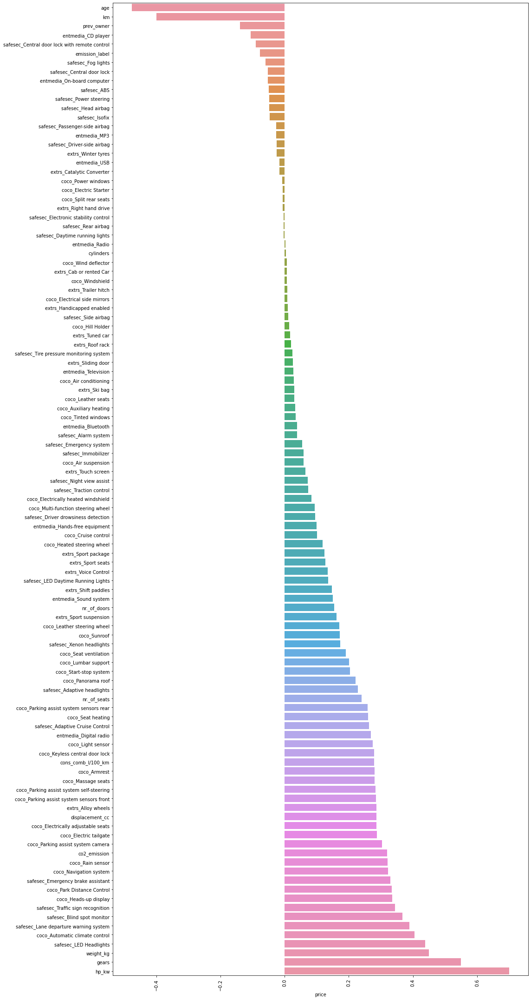

In [94]:
plt.figure(figsize = (16,30))
sns.barplot(x = corr_by_price, y = corr_by_price.index)
plt.xticks(rotation=90)
plt.tight_layout();

# Model Selection

I'll use linear regression model as a base model
And then I will use Ridge, Lasso, Elasticnet, KNeighborsRegressor and Support Vector MAchine Regressor
And then i will use ensemble models, like Randomforest, Gradient Boosting and Extra Trees
Finally I will look at the XGBoost Regresson.
And after evaluating the algorithm, we will select our best model.
Let's start.

## Features and target variable

In [95]:
X = df_final.drop("price", axis=1)
y = df_final['price']
# y = df_final.pop("price")

## Splitting data into training and testing

In [96]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, 
                                                    y, 
                                                    test_size=0.30, 
                                                    random_state=42)

In [110]:
split_set = [X_train, X_test, y_train, y_test]
for i in split_set:
    print(i.shape)

(10086, 166)
(4323, 166)
(10086,)
(4323,)


##  Model Building (Linear Regression)

In [111]:
from sklearn.linear_model import Ridge, Lasso, ElasticNet, LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn import model_selection
from sklearn.linear_model import RidgeCV, LassoCV, ElasticNetCV

In [168]:
def model_validation(y_train, y_train_pred, y_test, y_test_pred, model_name):
    
    scores =  {f"{model_name}_train": {"R2" : r2_score(y_train, y_train_pred),
    "rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mse" : mean_squared_error(y_train, y_train_pred), 
    "mae" : mean_absolute_error(y_train, y_train_pred)},
    
    f"{model_name}_test": {"R2" : r2_score(y_test, y_test_pred),
    "rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "mae" : mean_absolute_error(y_test, y_test_pred)}}
     
    return pd.DataFrame(scores)

In [178]:
def evaluation_metrics(actual, predicted):

    R2_score = r2_score(actual, predicted)
    rmse = np.sqrt(mean_squared_error(actual, predicted))
    mse = mean_squared_error(actual, predicted)
    mae = mean_absolute_error(actual, predicted)
   
    print("Model performance:")
    print("--------------------------")
    print(f"R2_score \t: {R2_score}")
    print(f"RMSE \t\t: {rmse}")
    print(f"MSE \t\t: {mse}")
    print(f"MAE \t\t: {mae}")

# Interpret the model

In [169]:
from sklearn.linear_model import LinearRegression
pd.options.display.float_format = '{:.3f}'.format

lm = LinearRegression()
lm.fit(X_train, y_train)

y_train_pred = lm.predict(X_train)
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
r2_score_train = r2_score(y_train, y_train_pred)

y_test_pred = lm.predict(X_test)
rmse_test= np.sqrt(mean_squared_error(y_test, y_test_pred))
r2_score_test = r2_score(y_test, y_test_pred)


print("Train Results")
print('r2: ', r2_score_train)
print('rmse:', rmse_train)

print()

print("Test Results")
print('r2: ', r2_score_test)
print('rmse:', rmse_test)

Train Results
r2:  0.8870215321813977
rmse: 2488.5893354844966

Test Results
r2:  0.8840996899677208
rmse: 2540.4153414932307


In [170]:
lin_model = model_validation(y_train, y_train_pred, y_test, y_test_pred, 'lm')
lin_model

,lm_train,lm_test
R2,0.887,0.884
rmse,2488.589,2540.415
mse,6193076.881,6453710.107
mae,1738.230,1752.253


Baseline Model,in our case, Linear Regression model, without and scaling and transformation did a quite a good job.

# Model Evaluation (Cross Validation)

In [171]:
from sklearn.model_selection import cross_validate, cross_val_score

In [172]:
model = LinearRegression()
scores = cross_validate(model, X_train, y_train, 
                 scoring = ['r2', 'neg_mean_absolute_error','neg_mean_squared_error', 'neg_root_mean_squared_error'], 
                 cv = 10)

In [173]:
scores = pd.DataFrame(scores)
scores

,fit_time,score_time,test_r2,test_neg_mean_absolute_error,test_neg_mean_squared_error,test_neg_root_mean_squared_error
0,0.473,0.023,0.885,-1778.825,-6198139.794,-2489.606
1,0.666,0.020,0.891,-1813.083,-6739059.824,-2595.970
2,0.429,0.018,0.887,-1704.716,-5690845.831,-2385.549
3,0.440,0.016,0.871,-1803.838,-6848667.673,-2616.996
4,0.350,0.015,0.866,-1752.877,-6902637.677,-2627.287
5,0.447,0.021,0.899,-1696.724,-5794474.565,-2407.171
6,0.463,0.021,0.873,-1745.098,-6567736.647,-2562.760
7,0.386,0.013,0.883,-1788.967,-6907498.142,-2628.212
8,0.349,0.016,0.875,-1796.978,-6617322.848,-2572.416
9,0.360,0.016,0.872,-1882.817,-7163132.108,-2676.403


In [174]:
scores.iloc[:,2:].mean()

test_r2                                   0.880
test_neg_mean_absolute_error          -1776.392
test_neg_mean_squared_error        -6542951.511
test_neg_root_mean_squared_error      -2556.237
dtype: float64

In [179]:
evaluation_metrics(y_test, y_test_pred)

Model performance:
--------------------------
R2_score 	: 0.8840996899677208
RMSE 		: 2540.4153414932307
MSE 		: 6453710.107294168
MAE 		: 1752.2534576216112


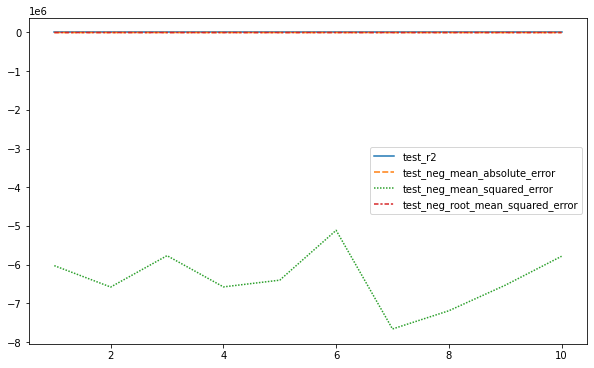

In [72]:
sns.lineplot(data = scores.iloc[:,2:]);

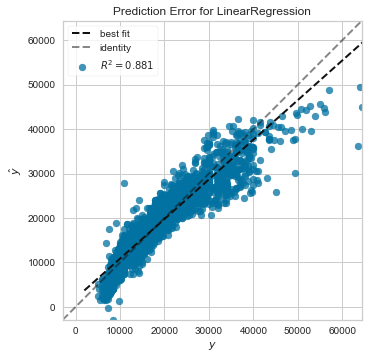

<AxesSubplot:title={'center':'Prediction Error for LinearRegression'}, xlabel='$y$', ylabel='$\\hat{y}$'>

In [73]:
from yellowbrick.regressor import PredictionError

# Instantiate the linear model and visualizer

#lm= LinearRegression(normalize=True)
visualizer = PredictionError(model)
visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()

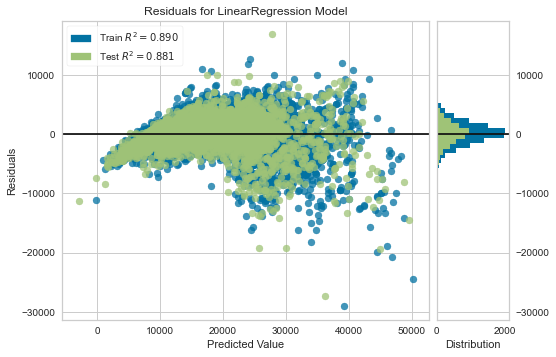

In [74]:
from yellowbrick.regressor import ResidualsPlot

# Instantiate the linear model and visualizer
model = LinearRegression()
visualizer = ResidualsPlot(model)

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show();        # Finalize and render the figure

# Regularization

### Polynomial Conversion

In [75]:
# from sklearn.preprocessing import PolynomialFeatures

In [76]:
# polynomial_converter = PolynomialFeatures(degree = 2, include_bias =False)

In [77]:
# PolynomialFeatures(degree = 2, include_bias =False)

In [78]:
# polynomial_converter.fit(X)

In [79]:
# poly_features = polynomial_converter.transform(X)

In [80]:
# poly_features

In [81]:
# poly_features.shape

In [82]:
# plt.plot(range(1,6), poly(6)["train_rmse_errors"], label = "TRAIN")
# plt.plot(range(1,6), poly(6)["test_rmse_errors"], label = "TEST")
# plt.xlabel("Polynamial Complex")
# plt.ylabel("RMSE")
# plt.legend();

## Scaling the Data

In [145]:
#from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler 

# (3 çeşit) (datada bir outlier riski varsa robustsclaer)

#scaler = MinMaxScaler()

In [146]:
#scaler.fit(X_train) 

# Datamdaki her bir feature ın ortalama ve std sapma bilgilerimi aldı ve atadı. 
# Sadece train ile yapılır, çünkü leakage olmaması gereklidir.

MinMaxScaler()

In [147]:
#X_train = scaler.transform(X_train)

In [148]:
#X_train

array([[5.44893763e-01, 2.50000000e-01, 1.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [7.37183002e-02, 2.50000000e-01, 1.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.43766278e-01, 2.50000000e-01, 1.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       ...,
       [4.93660041e-02, 2.50000000e-01, 1.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.42700480e-06, 2.50000000e-01, 1.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [6.51130912e-02, 2.50000000e-01, 1.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]])

In [149]:
#X_test = scaler.transform(X_test)  

# scale dikkat edeceğimiz en önemli husus. 
# kesinlikle tüm data üzerinde yapmıyoruz. 
# sadece X_train üzerinde eğitiyoruz.. 
# X_test i sadece dönüştürüyoruz.

In [150]:
#X_test  

# değerlerin z-score olarak neye karşılık geldiğini gösteriyor. 
# bu nedenle z-score-scaling olarakda adlandırılıyor

array([[0.26630912, 0.25      , 1.        , ..., 0.        , 0.        ,
        0.        ],
       [0.09805346, 0.25      , 1.        , ..., 0.        , 0.        ,
        0.        ],
       [0.04598012, 0.25      , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.37011652, 0.25      , 1.        , ..., 0.        , 0.        ,
        0.        ],
       [0.03416724, 0.25      , 1.        , ..., 0.        , 0.        ,
        0.        ],
       [0.03620288, 0.25      , 0.66666667, ..., 0.        , 0.        ,
        0.        ]])

In [151]:
#pd.DataFrame(X_train).agg(["mean", "std"]).round()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165
mean,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,1.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000
std,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000


In [152]:
#pd.DataFrame(X_test).agg(["mean", "std"]).round()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165
mean,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,1.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,1.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000
std,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000


# Ridge

In [153]:
from sklearn.linear_model import Ridge

In [154]:
ridge_model = Ridge(alpha=1)

In [155]:
ridge_model.fit(X_train, y_train)

Ridge(alpha=1)

In [156]:
y_train_pred = ridge_model.predict(X_train)
evaluation_metrics(y_train, y_train_pred)

Model testing performance:
--------------------------
R2_score 	: 0.8899010183879739
MAE 		: 1704.6063433999684
MSE 		: 6015693.426655038
RMSE 		: 2452.6910581349293


In [157]:
y_test_pred = ridge_model.predict(X_test)
evaluation_metrics(y_test, y_test_pred)

Model testing performance:
--------------------------
R2_score 	: 0.8811222352986277
MAE 		: 1757.865976042037
MSE 		: 6435322.884714681
RMSE 		: 2536.793819906277


In [158]:
ridge_scores = {"ridge_train": {"rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),
    "R2" : r2_score(y_train, y_train_pred)}, 

    "ridge_test": {"rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mae" : mean_absolute_error(y_test, y_test_pred),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "R2" : r2_score(y_test, y_test_pred)}}
rs = pd.DataFrame(ridge_scores)
rs

,ridge_train,ridge_test
rmse,2452.6910581,2539.7862968
mae,1704.6063434,1758.8722333
mse,6015693.4266550,6450514.4333785
R2,0.8899010,0.8808416


In [159]:
pd.concat([ls, rs], axis=1)

,lm_train,lm_test,ridge_train,ridge_test
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785
R2,0.8900378,0.8807073,0.8899010,0.8808416


### CV for Ridge Regression

In [160]:
ridgecv  = RidgeCV(alphas = 10**np.linspace(10,-2,100)*0.5, scoring = "neg_mean_squared_error", 
                   cv = 10, normalize = True)
ridgecv.fit(X_train, y_train)
ridgecv.alpha_

ridge_tuned = Ridge(alpha = ridgecv.alpha_).fit(X_train, y_train)

y_train_pred = ridge_tuned.predict(X_train)
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
r2_score_train = r2_score(y_train, y_train_pred)

y_test_pred = ridge_tuned.predict(X_test)
rmse_test= np.sqrt(mean_squared_error(y_test, y_test_pred))
r2_score_test = r2_score(y_test, y_test_pred)


print("Optimal lambda: " ,ridgecv.alpha_)

print()

print("Train Results")
print('rmse:', rmse_train)
print('r2: ', r2_score_train)

print()

print("Test Results")
print('rmse:', rmse_test)
print('r2: ', r2_score_test)

Optimal lambda:  0.005

Train Results
rmse: 2451.167012481118
r2:  0.8900378018133591

Test Results
rmse: 2541.1874135106405
r2:  0.8807100986234456


In [161]:
ridge_cv_scores = {"ridge_cv_train": {"rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),
    "R2" : r2_score(y_train, y_train_pred)}, 

    "ridge_cv_test": {"rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mae" : mean_absolute_error(y_test, y_test_pred),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "R2" : r2_score(y_test, y_test_pred)}}
rcvs = pd.DataFrame(ridge_cv_scores)
rcvs

,ridge_cv_train,ridge_cv_test
rmse,2451.1670125,2541.1874135
mae,1705.7423074,1759.4514210
mse,6008219.7230756,6457633.4705849
R2,0.8900378,0.8807101


In [162]:
pd.concat([ls, rs, rcvs], axis=1)

,lm_train,lm_test,ridge_train,ridge_test,ridge_cv_train,ridge_cv_test
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968,2451.1670125,2541.1874135
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333,1705.7423074,1759.4514210
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785,6008219.7230756,6457633.4705849
R2,0.8900378,0.8807073,0.8899010,0.8808416,0.8900378,0.8807101


# Lasso

In [163]:
from sklearn.linear_model import Lasso, LassoCV

In [164]:
lasso_model = Lasso(alpha = 1)

In [165]:
lasso_model.fit(X_train, y_train)

Lasso(alpha=1)

In [166]:
y_train_pred = lasso_model.predict(X_train)

In [167]:
evaluation_metrics(y_train, y_train_pred)

Model testing performance:
--------------------------
R2_score 	: 0.8893479704053832
MAE 		: 1706.9018847268273
MSE 		: 6045911.3911155965
RMSE 		: 2458.843506837228


In [168]:
y_test_pred = lasso_model.predict(X_test)

In [169]:
evaluation_metrics(y_test, y_test_pred)

Model testing performance:
--------------------------
R2_score 	: 0.8810682042286493
MAE 		: 1757.0548041403622
MSE 		: 6438247.799916363
RMSE 		: 2537.370252824046


In [170]:
lasso_scores = {"lasso_train": {"rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),
    "R2" : r2_score(y_train, y_train_pred)}, 

    "lasso_test": {"rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mae" : mean_absolute_error(y_test, y_test_pred),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "R2" : r2_score(y_test, y_test_pred)}}
lss = pd.DataFrame(lasso_scores)
lss

,lasso_train,lasso_test
rmse,2458.8435068,2537.3702528
mae,1706.9018847,1757.0548041
mse,6045911.3911156,6438247.7999164
R2,0.8893480,0.8810682


In [171]:
pd.concat([ls, rs, rcvs, lss], axis = 1)

,lm_train,lm_test,ridge_train,ridge_test,ridge_cv_train,ridge_cv_test,lasso_train,lasso_test
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968,2451.1670125,2541.1874135,2458.8435068,2537.3702528
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333,1705.7423074,1759.4514210,1706.9018847,1757.0548041
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785,6008219.7230756,6457633.4705849,6045911.3911156,6438247.7999164
R2,0.8900378,0.8807073,0.8899010,0.8808416,0.8900378,0.8807101,0.8893480,0.8810682


### CV for Lasso Regresion

In [172]:
lassocv  = LassoCV(alphas = 10**np.linspace(10,-2,100)*0.5, max_iter = 100000, cv = 10, normalize = True)
lassocv.fit(X_train, y_train)
lassocv.alpha_

lasso_tuned = Lasso(alpha = lassocv.alpha_).fit(X_train, y_train)

y_train_pred = lasso_tuned.predict(X_train)
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
r2_score_train = r2_score(y_train, y_train_pred)

y_test_pred = lasso_tuned.predict(X_test)
rmse_test= np.sqrt(mean_squared_error(y_test, y_test_pred))
r2_score_test = r2_score(y_test, y_test_pred)


print("Optimal lambda: " , lassocv.alpha_)

print()

print("Train Results")
print('rmse:', rmse_train)
print('r2: ', r2_score_train)

print()

print("Test Results")
print('rmse:', rmse_test)
print('r2: ', r2_score_test)

Optimal lambda:  0.10772173450159389

Train Results
rmse: 2451.438233924601
r2:  0.8900134658493172

Test Results
rmse: 2539.776655406661
r2:  0.8808425111174859


In [173]:
lasso_scores = {"lasso_cv_train": {"rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),
    "R2" : r2_score(y_train, y_train_pred)}, 

    "lasso_cv_test": {"rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mae" : mean_absolute_error(y_test, y_test_pred),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "R2" : r2_score(y_test, y_test_pred)}}
lcvs = pd.DataFrame(lasso_scores)
lcvs

,lasso_cv_train,lasso_cv_test
rmse,2451.4382339,2539.7766554
mae,1705.7934821,1758.8525028
mse,6009549.4147474,6450465.4593486
R2,0.8900135,0.8808425


In [174]:
pd.concat([ls, rs, rcvs, lss, lcvs], axis = 1)

,lm_train,lm_test,ridge_train,ridge_test,ridge_cv_train,ridge_cv_test,lasso_train,lasso_test,lasso_cv_train,lasso_cv_test
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968,2451.1670125,2541.1874135,2458.8435068,2537.3702528,2451.4382339,2539.7766554
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333,1705.7423074,1759.4514210,1706.9018847,1757.0548041,1705.7934821,1758.8525028
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785,6008219.7230756,6457633.4705849,6045911.3911156,6438247.7999164,6009549.4147474,6450465.4593486
R2,0.8900378,0.8807073,0.8899010,0.8808416,0.8900378,0.8807101,0.8893480,0.8810682,0.8900135,0.8808425


# ElasticNet 

In [175]:
from sklearn.linear_model import ElasticNet, ElasticNetCV

In [176]:
elastic_model = ElasticNet()
elastic_model.fit(X_train, y_train)

ElasticNet()

In [177]:
elastic_model.l1_ratio

0.5

In [178]:
elastic_model.alpha

1.0

In [179]:
y_train_pred = elastic_model.predict(X_train)
evaluation_metrics(y_train, y_train_pred)

Model testing performance:
--------------------------
R2_score 	: 0.5894241324969465
MAE 		: 3419.414734673154
MSE 		: 22433436.814019743
RMSE 		: 4736.394917447208


In [180]:
y_test_pred = elastic_model.predict(X_test)
evaluation_metrics(y_test, y_test_pred)

Model testing performance:
--------------------------
R2_score 	: 0.5935895206120649
MAE 		: 3412.052690341263
MSE 		: 22000604.277536944
RMSE 		: 4690.48017558298


In [181]:
elastic_scores = {"elastic_train": {"rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),
    "R2" : r2_score(y_train, y_train_pred)}, 

    "elastic_test": {"rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mae" : mean_absolute_error(y_test, y_test_pred),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "R2" : r2_score(y_test, y_test_pred)}}
es = pd.DataFrame(elastic_scores)
es

,elastic_train,elastic_test
rmse,4736.3949174,4690.4801756
mae,3419.4147347,3412.0526903
mse,22433436.8140197,22000604.2775369
R2,0.5894241,0.5935895


In [182]:
pd.concat([ls,rs, rcvs, lss, lcvs, es], axis = 1)

,lm_train,lm_test,ridge_train,ridge_test,ridge_cv_train,ridge_cv_test,lasso_train,lasso_test,lasso_cv_train,lasso_cv_test,elastic_train,elastic_test
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968,2451.1670125,2541.1874135,2458.8435068,2537.3702528,2451.4382339,2539.7766554,4736.3949174,4690.4801756
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333,1705.7423074,1759.4514210,1706.9018847,1757.0548041,1705.7934821,1758.8525028,3419.4147347,3412.0526903
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785,6008219.7230756,6457633.4705849,6045911.3911156,6438247.7999164,6009549.4147474,6450465.4593486,22433436.8140197,22000604.2775369
R2,0.8900378,0.8807073,0.8899010,0.8808416,0.8900378,0.8807101,0.8893480,0.8810682,0.8900135,0.8808425,0.5894241,0.5935895


### CV for ElastikNet

In [183]:
enet_cv  = ElasticNetCV(alphas = 10**np.linspace(10,-2,100)*0.5, l1_ratio=[.1,.2,.3,.5,.7,.8,.9,1], 
                        max_iter=100000, cv = 10, normalize = True)
enet_cv.fit(X_train, y_train)
enet_cv.alpha_

enet_tuned = ElasticNet(alpha = enet_cv.alpha_, l1_ratio=enet_cv.l1_ratio_).fit(X_train, y_train)

y_train_pred = enet_tuned.predict(X_train)
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
r2_score_train = r2_score(y_train, y_train_pred)

y_test_pred = enet_tuned.predict(X_test)
rmse_test= np.sqrt(mean_squared_error(y_test, y_test_pred))
r2_score_test = r2_score(y_test, y_test_pred)


print('Optimal lambda: ', enet_cv.alpha_)
print("Optimal l1_ratio", enet_cv.l1_ratio_)

print()

print("Train Results")
print('rmse:', rmse_train)
print('r2: ', r2_score_train)

print()

print("Test Results")
print('rmse:', rmse_test)
print('r2: ', r2_score_test)

Optimal lambda:  0.10772173450159389
Optimal l1_ratio 1.0

Train Results
rmse: 2451.438233924601
r2:  0.8900134658493172

Test Results
rmse: 2539.776655406661
r2:  0.8808425111174859


In [184]:
elastic_cv_scores = {"elastic_cv_train": {"rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred)),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),
    "R2" : r2_score(y_train, y_train_pred)}, 

    "elastic_cv_test": {"rmse" : np.sqrt(mean_squared_error(y_test, y_test_pred)),
    "mae" : mean_absolute_error(y_test, y_test_pred),
    "mse" : mean_squared_error(y_test, y_test_pred),
    "R2" : r2_score(y_test, y_test_pred)}}
ecvs = pd.DataFrame(elastic_cv_scores)
ecvs

,elastic_cv_train,elastic_cv_test
rmse,2451.4382339,2539.7766554
mae,1705.7934821,1758.8525028
mse,6009549.4147474,6450465.4593486
R2,0.8900135,0.8808425


In [185]:
pd.concat([ls,rs, rcvs, lss, lcvs, es, ecvs], axis = 1)

,lm_train,lm_test,ridge_train,ridge_test,ridge_cv_train,ridge_cv_test,lasso_train,lasso_test,lasso_cv_train,lasso_cv_test,elastic_train,elastic_test,elastic_cv_train,elastic_cv_test
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968,2451.1670125,2541.1874135,2458.8435068,2537.3702528,2451.4382339,2539.7766554,4736.3949174,4690.4801756,2451.4382339,2539.7766554
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333,1705.7423074,1759.4514210,1706.9018847,1757.0548041,1705.7934821,1758.8525028,3419.4147347,3412.0526903,1705.7934821,1758.8525028
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785,6008219.7230756,6457633.4705849,6045911.3911156,6438247.7999164,6009549.4147474,6450465.4593486,22433436.8140197,22000604.2775369,6009549.4147474,6450465.4593486
R2,0.8900378,0.8807073,0.8899010,0.8808416,0.8900378,0.8807101,0.8893480,0.8810682,0.8900135,0.8808425,0.5894241,0.5935895,0.8900135,0.8808425


# Grid Search

In [186]:
from sklearn.model_selection import GridSearchCV

In [187]:
elastic_model = ElasticNet(max_iter=100000)

In [188]:
param_grid ={"alpha":[0.01, 0.02, 0.1, 1, 5, 10, 50, 100],
            "l1_ratio":[0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1]}

In [189]:
grid_model = GridSearchCV(estimator = elastic_model, param_grid = param_grid, scoring = 'neg_root_mean_squared_error',
                         cv =10, verbose =2)

In [190]:
grid_model.fit(X_train, y_train)

Fitting 10 folds for each of 56 candidates, totalling 560 fits
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   4.7s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   3.0s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   1.2s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   1.2s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   0.8s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   1.5s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   2.1s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   3.4s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   1.4s
[CV] END ...........................alpha=0.01, l1_ratio=0.1; total time=   1.2s
[CV] END ...........................alpha=0.01, l1_ratio=0.5; total time=   0.9s
[CV] END ...........................alpha=0.01

GridSearchCV(cv=10, estimator=ElasticNet(max_iter=100000),
             param_grid={'alpha': [0.01, 0.02, 0.1, 1, 5, 10, 50, 100],
                         'l1_ratio': [0.1, 0.5, 0.7, 0.9, 0.95, 0.99, 1]},
             scoring='neg_root_mean_squared_error', verbose=2)

In [191]:
grid_model.best_params_

{'alpha': 1, 'l1_ratio': 1}

In [192]:
pd.DataFrame(grid_model.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_l1_ratio,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,2.1336370,1.1962793,0.0034002,0.0018932,0.0100000,0.1000000,"{'alpha': 0.01, 'l1_ratio': 0.1}",-2622.4169931,-2832.5709897,-2621.3481089,-2702.6424397,-2714.6282306,-2420.7644500,-3044.7282892,-2863.9313676,-2663.7785305,-2631.3808915,-2711.8190291,160.7197994,18
1,1.2842050,0.5747702,0.0034987,0.0022014,0.0100000,0.5000000,"{'alpha': 0.01, 'l1_ratio': 0.5}",-2552.3147800,-2746.1051413,-2553.4388490,-2646.6301978,-2649.1264587,-2351.3000879,-2955.8538678,-2797.8756907,-2596.1045763,-2558.8125035,-2640.7562153,155.9216539,15
2,0.8579812,0.2726291,0.0022005,0.0009827,0.0100000,0.7000000,"{'alpha': 0.01, 'l1_ratio': 0.7}",-2509.9171796,-2687.7792168,-2507.6822971,-2609.7462717,-2605.2744514,-2308.3710870,-2896.9566173,-2756.8744982,-2551.1178407,-2510.8295367,-2594.4548997,152.4267341,14
3,2.4728914,1.2702214,0.0029991,0.0016111,0.0100000,0.9000000,"{'alpha': 0.01, 'l1_ratio': 0.9}",-2460.9467210,-2606.5651437,-2442.6277448,-2561.6405049,-2547.4121321,-2258.5829687,-2817.4562128,-2703.5954464,-2490.2847223,-2444.4260030,-2533.3537600,146.5572191,9
4,3.9443676,0.7746648,0.0033994,0.0020579,0.0100000,0.9500000,"{'alpha': 0.01, 'l1_ratio': 0.95}",-2450.4705774,-2582.0983864,-2421.2143116,-2550.0490269,-2532.4615602,-2249.1704155,-2792.8179471,-2687.9376679,-2473.6121671,-2423.3827162,-2516.3214776,143.8193897,6
5,7.2878559,2.5074285,0.0018064,0.0009960,0.0100000,0.9900000,"{'alpha': 0.01, 'l1_ratio': 0.99}",-2450.2583504,-2566.4049511,-2404.4159888,-2551.4246837,-2527.2672243,-2253.7618030,-2773.0199678,-2679.2823265,-2485.8956883,-2407.6753151,-2509.9406299,139.4482251,3
6,8.7368011,4.2857294,0.0034994,0.0033819,0.0100000,1,"{'alpha': 0.01, 'l1_ratio': 1}",-2454.6661753,-2565.1633959,-2401.7735962,-2563.3101128,-2529.9050245,-2260.8714017,-2768.2705562,-2681.6258528,-2554.7637483,-2405.0533520,-2518.5403216,138.4082217,8
7,1.7965745,0.6032618,0.0030508,0.0025328,0.0200000,0.1000000,"{'alpha': 0.02, 'l1_ratio': 0.1}",-2747.8748794,-2974.2580678,-2734.5116686,-2798.1845612,-2822.2352329,-2541.9146469,-3190.1543256,-2983.4362388,-2775.8885192,-2753.2028418,-2832.1660982,168.1580760,23
8,2.6076440,1.1482132,0.0028349,0.0017938,0.0200000,0.5000000,"{'alpha': 0.02, 'l1_ratio': 0.5}",-2638.0331934,-2850.8689996,-2635.7833550,-2714.6397550,-2728.4850571,-2436.0158149,-3063.5878754,-2878.6763701,-2678.1645250,-2646.9189710,-2727.1173916,161.7098424,19
9,2.1375213,0.7214390,0.0041041,0.0025072,0.0200000,0.7000000,"{'alpha': 0.02, 'l1_ratio': 0.7}",-2571.3358610,-2770.5152305,-2572.5689457,-2662.2407876,-2667.5895199,-2370.3410413,-2980.8097016,-2815.8935004,-2615.1257995,-2579.1181241,-2660.5538512,157.3080486,17


In [131]:
#new_model = ElasticNet(alpha =0.1, l1_ratio=0.1)
#new_model

### Using Best Model From GridSearch

In [193]:
y_train_pred = grid_model.predict(X_train)

In [194]:
y_test_pred = grid_model.predict(X_test)

In [195]:
evaluation_metrics(y_train, y_train_pred)

Model testing performance:
--------------------------
R2_score 	: 0.8893479704053832
MAE 		: 1706.9018847268273
MSE 		: 6045911.3911155965
RMSE 		: 2458.843506837228


In [196]:
evaluation_metrics(y_test, y_test_pred)

Model testing performance:
--------------------------
R2_score 	: 0.8810682042286493
MAE 		: 1757.0548041403622
MSE 		: 6438247.799916363
RMSE 		: 2537.370252824046


# Study with Kaan Hoca

## Ridge & Lasso & Elasticnet & KNN with Scaler and Transformer

In [197]:
rmse_test =[]
r2_test =[]
model_names =[]
numerical2= df_final.drop(['price'], axis=1).select_dtypes('number').columns
X= df_final.drop('price', axis=1)
y= df_final['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
s = StandardScaler()
p= PowerTransformer(method='yeo-johnson', standardize=True)
rr = Ridge()
las = Lasso()
el= ElasticNet()
knn = KNeighborsRegressor()
models = [rr,las,el,knn]
for model in models:
    ct = make_column_transformer((s,numerical2),(p,skew_cols.index),remainder='passthrough')  
    pipe = make_pipeline(ct, model)
    pipe.fit(X_train, y_train)
    y_test_pred = pipe.predict(X_test)
    rmse_test.append(round(np.sqrt(mean_squared_error(y_test, y_test_pred)),2))
    r2_test.append(round(r2_score(y_test, y_test_pred),2))
    print (f'model : {model} and  rmse score is : {round(np.sqrt(mean_squared_error(y_test, y_test_pred)),2)}, r2 score is {round(r2_score(y_test, y_test_pred),2)}')
model_names = ['Ridge','Lasso','ElasticNet','KNeighbors']
result_df = pd.DataFrame({'RMSE':rmse_test,'R2_Test':r2_test}, index=model_names)
result_df

model : Ridge() and  rmse score is : 2495.09, r2 score is 0.88
model : Lasso() and  rmse score is : 2494.94, r2 score is 0.89
model : ElasticNet() and  rmse score is : 2822.55, r2 score is 0.85
model : KNeighborsRegressor() and  rmse score is : 2922.64, r2 score is 0.84


,RMSE,R2_Test
Ridge,2495.0900000,0.8800000
Lasso,2494.9400000,0.8900000
ElasticNet,2822.5500000,0.8500000
KNeighbors,2922.6400000,0.8400000


In [137]:
# pd.concat([ls,rs, rcvs, lss, lcvs, es, ecvs], axis = 1)

- By using standard scaler and power transformer for the skewness;
- For linear models we got .92 for the R2 and
- 2307.47 RMSE which are better scores compare to the baseline model.


## Random Forest& Gradient Boosting & Extra Trees & XGBoost

In [198]:
rmse_test =[]
r2_test =[]
model_names =[]



X= df_final.drop('price', axis=1)
y= df_final['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)


rf = RandomForestRegressor(random_state=42)
gb = GradientBoostingRegressor(random_state=42)
et= ExtraTreesRegressor(random_state=42)
xgb = XGBRegressor(random_state=42)

models = [rf,gb,et,xgb]

for model in models:
    model.fit(X_train, y_train)
    y_test_pred = model.predict(X_test)
    rmse_test.append(round(np.sqrt(mean_squared_error(y_test, y_test_pred)),2))
    r2_test.append(round(r2_score(y_test, y_test_pred),2))
    print (f'model : {model} and  rmse score is : {round(np.sqrt(mean_squared_error(y_test, y_test_pred)),2)}, r2 score is {round(r2_score(y_test, y_test_pred),4)}')

model_names = ['RandomForest','GradientBoost','ExtraTree','XGB']
#result_df = pd.DataFrame({'RMSE':rmse_test,'R2_Test':r2_test}, index=model_names)
result_df = pd.DataFrame({'rmse':rmse_test,'R2':r2_test}, index=model_names)
result_df


model : RandomForestRegressor(random_state=42) and  rmse score is : 1611.17, r2 score is 0.952
model : GradientBoostingRegressor(random_state=42) and  rmse score is : 2001.98, r2 score is 0.926
model : ExtraTreesRegressor(random_state=42) and  rmse score is : 1642.57, r2 score is 0.9502
model : XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=100, n_jobs=8, num_parallel_tree=1, random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None) and  rmse score is : 1573.17, r2 score is 0.9543


,rmse,R2
RandomForest,1611.1700000,0.9500000
GradientBoost,2001.9800000,0.9300000
ExtraTree,1642.5700000,0.9500000
XGB,1573.1700000,0.9500000


In [199]:
result_df.reset_index()

,index,rmse,R2
0,RandomForest,1611.1700000,0.9500000
1,GradientBoost,2001.9800000,0.9300000
2,ExtraTree,1642.5700000,0.9500000
3,XGB,1573.1700000,0.9500000


In [200]:
kaan = result_df.T

Now we are talking.
Random forest, without any tuning got .94 R2 and lowest RMSE.
XGBoost also did a good job without any optimization / tuning


In [201]:
pd.concat([ls,rs, rcvs, lss, lcvs, es, ecvs, kaan], axis = 1)

,lm_train,lm_test,ridge_train,ridge_test,ridge_cv_train,ridge_cv_test,lasso_train,lasso_test,lasso_cv_train,lasso_cv_test,elastic_train,elastic_test,elastic_cv_train,elastic_cv_test,RandomForest,GradientBoost,ExtraTree,XGB
rmse,2451.1669279,2541.2167754,2452.6910581,2539.7862968,2451.1670125,2541.1874135,2458.8435068,2537.3702528,2451.4382339,2539.7766554,4736.3949174,4690.4801756,2451.4382339,2539.7766554,1611.1700000,2001.9800000,1642.5700000,1573.1700000
mae,1705.7547720,1759.4703066,1704.6063434,1758.8722333,1705.7423074,1759.4514210,1706.9018847,1757.0548041,1705.7934821,1758.8525028,3419.4147347,3412.0526903,1705.7934821,1758.8525028,NaN,NaN,NaN,NaN
mse,6008219.3081963,6457782.6995524,6015693.4266550,6450514.4333785,6008219.7230756,6457633.4705849,6045911.3911156,6438247.7999164,6009549.4147474,6450465.4593486,22433436.8140197,22000604.2775369,6009549.4147474,6450465.4593486,NaN,NaN,NaN,NaN
R2,0.8900378,0.8807073,0.8899010,0.8808416,0.8900378,0.8807101,0.8893480,0.8810682,0.8900135,0.8808425,0.5894241,0.5935895,0.8900135,0.8808425,0.9500000,0.9300000,0.9500000,0.9500000


## Best Model with the Hyperparameter Tuning

In [202]:
X= df_final.drop('price', axis=1)
y= df_final['price']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

rf = RandomForestRegressor(n_estimators= 220, random_state=42 )

rf.fit(X_train, y_train)
y_test_pred = rf.predict(X_test)
print (f' rmse score is : {round(np.sqrt(mean_squared_error(y_test, y_test_pred)),4)}, r2 score is {round(r2_score(y_test, y_test_pred),4)}')

 rmse score is : 1604.728, r2 score is 0.9524


With hyperparameter tuning we got a lift.
RMSE (from 1984.44 to 1975.8483)
R2 (from .9432 to .9437)

## Feature Importance

km : 0.061
prev_owner : 0.001
nr._of_seats : 0.001
cylinders : 0.006
co2_emission : 0.004
gears : 0.027
age : 0.198
hp_kw : 0.496
displacement_cc : 0.011
weight_kg : 0.016
cons_comb_l/100_km : 0.011
coco_Armrest : 0.002
coco_Automatic climate control : 0.001
coco_Electrically adjustable seats : 0.001
coco_Heads-up display : 0.003
coco_Hill Holder : 0.002
coco_Parking assist system camera : 0.001
coco_Seat heating : 0.001
entmedia_Bluetooth : 0.002
safesec_LED Headlights : 0.004
safesec_Power steering : 0.004
safesec_Xenon headlights : 0.003
make_model_Audi A3 : 0.014
make_model_Opel Astra : 0.007
make_model_Opel Corsa : 0.002
make_model_Opel Insignia : 0.005
make_model_Renault Clio : 0.002
make_model_Renault Espace : 0.055
gearing_type_Manual : 0.011
gearing_type_Semi-automatic : 0.007
upholstery_type_Full leather : 0.002
upholstery_color_Black : 0.001



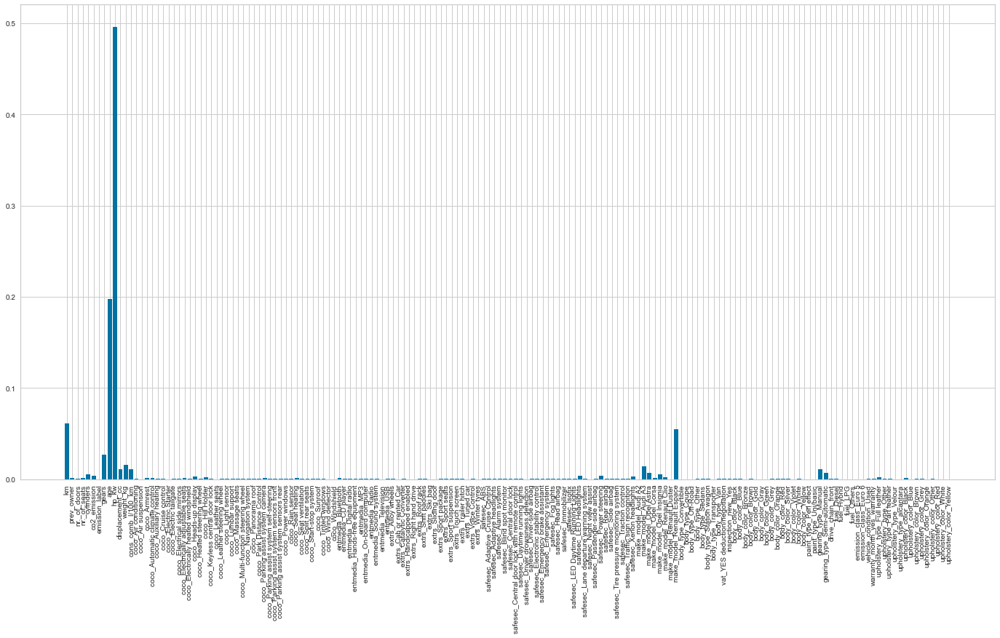

In [205]:
importances = rf.feature_importances_
feature_names = [f'feature {i}' for i in range(X.shape[1])]

# what are scores for the features
for i in range(len(rf.feature_importances_)):
    if rf.feature_importances_[i] >0.001:
        print(f'{X_train.columns[i]} : {round(rf.feature_importances_[i],3)}')

print()

plt.bar([X_train.columns[i] for i in range(len(rf.feature_importances_))], rf.feature_importances_)
plt.xticks(rotation=90)
plt.rcParams["figure.figsize"] = (24,12)
plt.show()

Based on the Random Forest Regressor:
enginesize
curbweight
highway mpg
horse power
have biggest importance scores.
It is important to note that Random Forest Regressor gave importance score bigger than 0 to 16 features.
Model used 16 out of 63 features to get best prediction.
For For deatiled discussion on the Feature Selection-The Most Common Methods to Know


We have developed model to predict car price problem.

First, we made the detailed exploratory analysis.

We have decided which metric to use.

We analyzed both target and features in detail.

We transform categorical variables into numeric so we can use them in the model.

We transform numerical variables to reduce skewness and get close to normal distribution.

We use pipeline to avoid data leakage.

We looked at the results of the each model and selected the best one for the problem in hand.

We made hyperparameter tuning of the best model see the improvement

We looked at the feature importance.

After this point it is up to you to develop and improve the models. Enjoy 🤘
By the way, when you like the topic, you can show it by supporting 👍
Feel free to leave a comment.
All the best 🤘